# STOCKS DATA ANALYSIS AND VISUALIZATION

## IMPORT DATASETS AND LIBRARIES

In [ ]:
# Mount the drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from copy import copy
from scipy import stats
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go

In [ ]:
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from tqdm.notebook import tqdm

In [ ]:
# Read the stock data csv file, here's the list of the stocks considered:

# AAPL = Apple Stock 
# BA = Boeing 
# T = AT&T
# MGM = MGM Resorts International (Hotel Industry)
# AMZN = Amazon
# IBM = IBM
# TSLA = Tesla Motors
# GOOG = Google 
# sp500 = US Stock Market (S&P 500 is a stock market index that measures the stock performance of 500 large companies listed on U.S. stock exchange)
# Check the list of S&P 500 companies here: https://en.wikipedia.org/wiki/List_of_S%26P_500_companies

stocks_df = pd.read_csv('/content/drive/MyDrive/my files/Financial Analysis/stock.csv')
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [ ]:
# Sort the stock data by date
stocks_df = stocks_df.sort_values(by = ['Date'])
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [ ]:
# Print out the number of stocks
print('Total Number of stocks : {}'.format(len(stocks_df.columns[1:])))

Total Number of stocks : 9


In [ ]:
# Print the name of stocks
print('Stocks under consideration are:')

for i in stocks_df.columns[1:]:
  print(i)

Stocks under consideration are:
AAPL
BA
T
MGM
AMZN
IBM
TSLA
GOOG
sp500


In [ ]:
stocks_df.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000
mean,140.819823,189.942700,35.162899,23.105743,915.665665,161.853001,259.600815,783.712512,2218.749554
std,70.827601,103.678586,3.207490,6.963847,697.838905,25.561938,210.988003,334.448057,537.321727
min,55.790001,67.239998,26.770000,7.140000,175.929993,94.769997,22.790001,278.481171,1278.040039
25%,89.165714,124.015000,33.040001,18.545000,316.490005,142.769997,184.595001,527.214416,1847.984985
50%,116.599998,142.419998,34.930000,23.780001,676.010010,156.949997,231.960007,737.599976,2106.629883
75%,175.019997,297.044998,37.419998,28.430000,1593.645019,185.974998,307.350006,1079.744995,2705.810059
max,455.609985,440.619995,43.470001,38.029999,3225.000000,215.800003,1643.000000,1568.489990,3386.149902


In [ ]:
# Check if data contains any null values
stocks_df.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [ ]:
# Getting dataframe info
stocks_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2159 non-null   object 
 1   AAPL    2159 non-null   float64
 2   BA      2159 non-null   float64
 3   T       2159 non-null   float64
 4   MGM     2159 non-null   float64
 5   AMZN    2159 non-null   float64
 6   IBM     2159 non-null   float64
 7   TSLA    2159 non-null   float64
 8   GOOG    2159 non-null   float64
 9   sp500   2159 non-null   float64
dtypes: float64(9), object(1)
memory usage: 185.5+ KB


## PLOT THE DATA

In [ ]:
# Define a function to plot the entire dataframe
# The function takes in a dataframe df as an input argument and does not return anything back!
# The function performs data visualization
# Pandas works great with matplotlib, you can simply plot data directly from a Pandas DataFrame using plot() method

def show_plot(df, fig_title):
  df.plot(x = 'Date', figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()

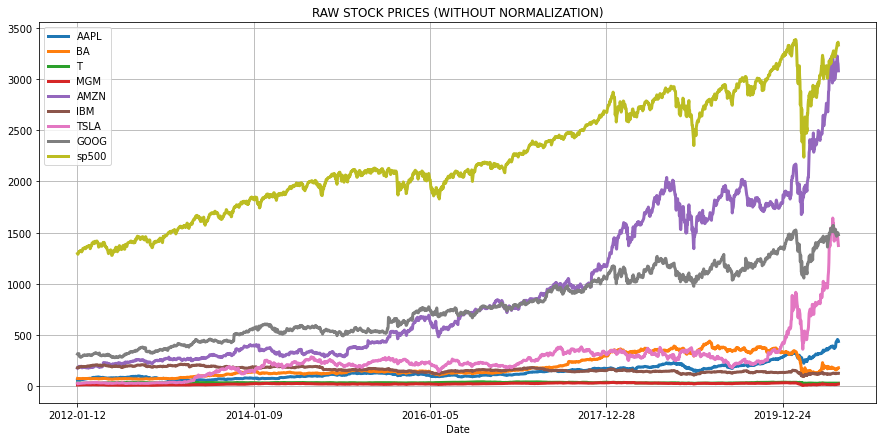

In [ ]:
# Plot the data
show_plot(stocks_df, 'RAW STOCK PRICES (WITHOUT NORMALIZATION)')

Print out normalized (scaled) stock prices

In [ ]:
def normalize(df):
    x = df.copy()
    for i in x.columns[1:]:
        x[i] = x[i]/x[i][0]
    return x

In [ ]:
normalize(stocks_df)

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2012-01-13,0.996251,0.987949,0.998340,1.018137,1.014153,0.992301,0.806726,0.992615,0.995052
2,2012-01-17,1.007855,0.996424,1.004316,1.009893,1.032570,0.996954,0.941593,0.998317,0.998587
3,2012-01-18,1.018320,0.994040,1.006972,1.049464,1.076792,1.002880,0.949027,1.005193,1.009680
4,2012-01-19,1.015093,1.000662,1.009960,1.055235,1.105269,0.999834,0.947257,1.015771,1.014666
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,7.313297,2.308039,0.991036,1.378401,18.217644,0.694821,52.567080,4.698347,2.568715
2155,2020-08-06,7.568452,2.280493,0.990704,1.521847,18.331155,0.698532,52.728494,4.782805,2.585226
2156,2020-08-07,7.383066,2.251622,0.996680,1.568838,18.004093,0.692107,51.423361,4.764919,2.586862
2157,2020-08-10,7.490377,2.375977,1.002656,1.784831,17.894390,0.704016,50.214865,4.770052,2.593956


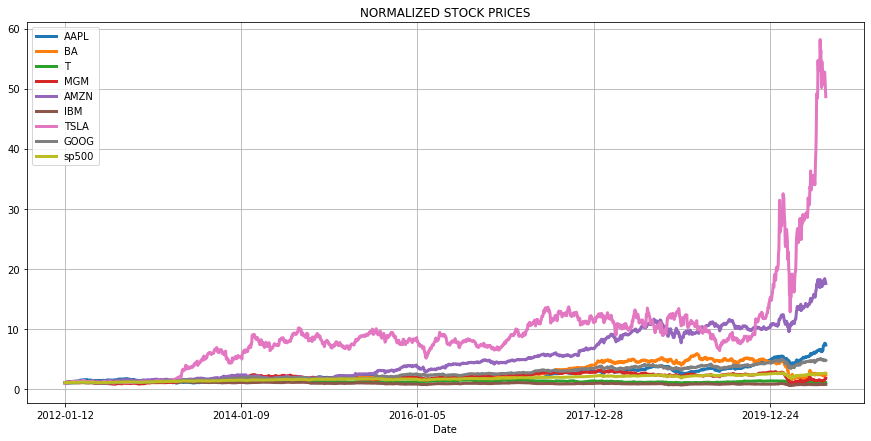

In [ ]:
show_plot(normalize(stocks_df), 'NORMALIZED STOCK PRICES')

## PERFORM INTERACTIVE DATA VISUALIZATION

In [ ]:
# Function to perform an interactive data plotting using plotly express
# Plotly.express module which is imported as px includes functions that can plot interactive plots easily and effectively. 
# Every Plotly Express function uses graph objects internally and returns a plotly.graph_objects.Figure instance. 

def interactive_plot(df, title):
  fig = px.line(title = title)
  
  # Loop through each stock (while ignoring time columns with index 0)
  for i in df.columns[1:]:
    fig.add_scatter(x = df['Date'], y = df[i], name = i) # add a new Scatter trace

  fig.show()

In [ ]:
# Plot interactive chart
interactive_plot(stocks_df, 'Prices')

In [ ]:
interactive_plot(normalize(stocks_df), 'Normalized Prices')

## CALCULATE MULTIPLE STOCKS DAILY RETURNS


\begin{align}
Daily\,Stock\,Return = \frac{Today\,Price- Yesterday\,Price}{Yesterday\,Price}*100
\end{align}

In [ ]:
# Let's define a function to calculate stocks daily returns (for all stocks) 
def daily_return(df):
  df_daily_return = df.copy()

  # Loop through each stock (while ignoring time columns with index 0)
  for i in df.columns[1:]:
    
    # Loop through each row belonging to the stock
    for j in range(1, len(df)):

      # Calculate the percentage of change from the previous day
      df_daily_return[i][j] = ((df[i][j]- df[i][j-1])/df[i][j-1]) * 100
    
    # set the value of first row to zero since the previous value is not available
    df_daily_return[i][0] = 0
  
  return df_daily_return

In [ ]:
# Get the daily returns 
stocks_daily_return = daily_return(stocks_df)
stocks_daily_return

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.374946,-1.205144,-0.166006,1.813685,1.415339,-0.769869,-19.327430,-0.738516,-0.494792
2,2012-01-17,1.164812,0.857909,0.598603,-0.809717,1.815943,0.468852,16.717854,0.574410,0.355295
3,2012-01-18,1.038382,-0.239234,0.264463,3.918367,4.282725,0.594448,0.789470,0.688856,1.110793
4,2012-01-19,-0.316937,0.666134,0.296736,0.549882,2.644634,-0.303752,-0.186494,1.052283,0.493866
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.362467,5.579446,-0.533156,0.000000,2.109065,-0.309917,-0.133153,0.589774,0.642974
2155,2020-08-06,3.488923,-1.193483,-0.033501,10.406699,0.623082,0.534082,0.307062,1.797626,0.642770
2156,2020-08-07,-2.449458,-1.265966,0.603217,3.087768,-1.784187,-0.919762,-2.475194,-0.373974,0.063303
2157,2020-08-10,1.453480,5.522880,0.599604,13.767729,-0.609323,1.720552,-2.350092,0.107728,0.274222


In [ ]:
stocks_daily_return.mean()

AAPL     0.107695
BA       0.065907
T        0.008159
MGM      0.064662
AMZN     0.151122
IBM     -0.006091
TSLA     0.238398
GOOG     0.084392
sp500    0.049316
dtype: float64

Plot the returns vs. time using both static and interactive plots

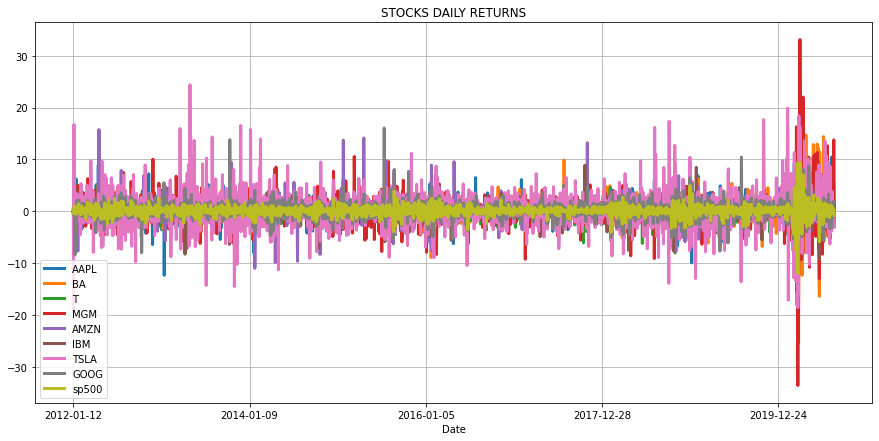

In [ ]:
# Plot the daily returns
# Notice huge drops in MGM around March 2020 (Pandemic effect)
show_plot(stocks_daily_return, 'STOCKS DAILY RETURNS')

In [ ]:
# Plot the interactive chart
# Zoom in to view the sharp decline during March 2020
interactive_plot(stocks_daily_return, 'STOCKS DAILY RETURNS')

## CALCULATE THE CORRELATIONS BETWEEN DAILY RETURNS

In [ ]:
# Daily Return Correlation
cm = stocks_daily_return.drop(columns = ['Date']).corr()

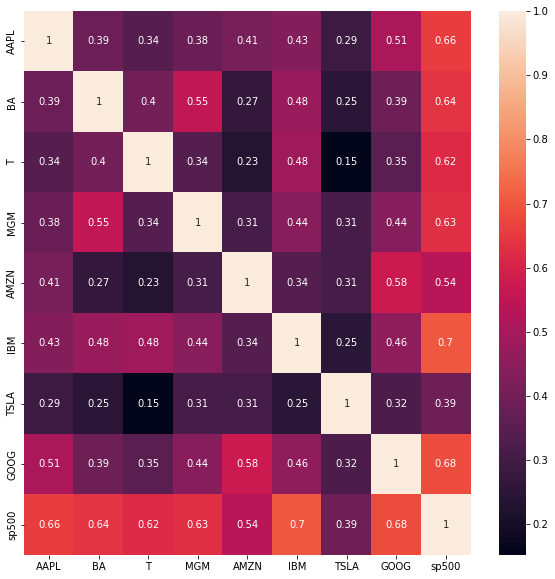

In [ ]:
plt.figure(figsize=(10, 10))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax);

## PLOT THE HISTOGRAM FOR DAILY RETURNS

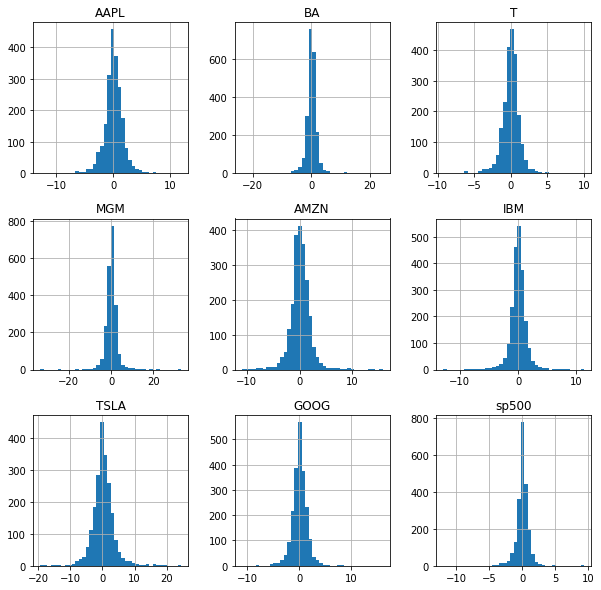

In [ ]:
# Histogram of daily returns
# Stock returns are normally distributed with zero mean 
# Notice how Tesla Standard deviation is high indicating a more volatile stock
stocks_daily_return.hist(figsize=(10, 10), bins = 40);

In [ ]:
# Group all data returns together in a list
# Make a copy of the daily returns dataframe
df_hist = stocks_daily_return.copy()

# Drop the date
df_hist = df_hist.drop(columns = ['Date'])

data = []

# Loop through every column
for i in df_hist.columns:
  data.append(stocks_daily_return[i].values)
data

[array([ 0.        , -0.37494578,  1.16481192, ..., -2.44945751,
         1.45347999, -2.9739868 ]),
 array([ 0.        , -1.20514366,  0.85790887, ..., -1.26596576,
         5.52287953,  0.40131597]),
 array([ 0.        , -0.16600597,  0.59860326, ...,  0.60321716,
         0.5996036 ,  0.        ]),
 array([ 0.        ,  1.81368508, -0.8097166 , ...,  3.08776831,
        13.76772918, -0.69284065]),
 array([ 0.        ,  1.41533854,  1.8159433 , ..., -1.78418726,
        -0.60932259, -2.14379167]),
 array([ 0.        , -0.76986928,  0.46885241, ..., -0.91976211,
         1.72055219, -0.28322004]),
 array([  0.        , -19.32743009,  16.71785359, ...,  -2.47519409,
         -2.35009162,  -3.1143992 ]),
 array([ 0.        , -0.73851634,  0.57441015, ..., -0.37397414,
         0.10772812, -1.05474435]),
 array([ 0.        , -0.49479228,  0.35529545, ...,  0.06330295,
         0.27422185, -0.79691324])]

In [ ]:
# Plotly's Python API contains a super powerful module known as figure factory module 
# Figure factory module includes wrapper functions that create unique chart types such as interactive subplots 
# Check this out for more information: https://plotly.com/python/figure-factory-subplots/
# Notice how Boeing, Tesla and MGM gains are losses are sometimes extreme! This will indicate a more risky investment and will be quantified later using Sharpe Ratio
fig = ff.create_distplot(data, df_hist.columns)
fig.show()

# PORTFOLIO ASSETS ALLOCATION AND STATISTICAL DATA ANALYSIS
A portfolio is a collection of financial investments such as stocks, fixed income securities (bonds), cash, mutual funds and Exchange Traded Funds (ETFs). Let's assume that you have $1M dollars to invest in the market, how can you allocate these assets among a selected set of securities? Should you invest them all in Apple? S&P500? Bonds? The answer depends on many factors such as client's risk tolerance, target returns and investment time span.

## TYPES OF ASSETS

### 1. EQUITIES (STOCKS):


*   A stock simply represents an ownership of a certain percentage
of a company.
*   A stock gives the owner the right to some shares in a given
company depending on how much stock (shares) they own.
*   Stocks are traded on stock exchanges such as New York Stock
Exchange (NYSE) and regular individuals can buy them via online brokerage firms.
*   Stocks are generally liquid as compared to real estate which could take a much longer time to sell.



### 2. FIXED INCOME SECURITIES (BONDS):


*   Abond is a fixed income that are generally issued by
governments or corporations and represents a loan made by an investor to the borrower.
*   Bonds pay the investor a fixed stated interest rate.
*   Bonds are used by companies and Governments to raise money to fund future projects.
*   Bonds that are less risky such as U.S. Government Bonds pay less interest compared to high risk bonds.
*   Bond coupons represent a semi-annual interest payments to the bond holder.




### 3. EXCHANGE TRADED FUNDS (ETFs):


*   ETFs are a type of security that includes a group of securities and
possibly track an index such as the S&P500.
*   ETFs are like mutual funds however they are marketable securities and are being traded on exchanges similar to any other stock. 
*   ETFs can include a collection of stocks, bonds, and commodities.
*   ETFs have generally low management fees and offer a tool for risk diversification.
*   Vanguard S&P 500 ETF (VOO): https://investor.vanguard.com/etf/profile/performance/voo




## UNERSTAND THE CONCEPT OF ASSET ALLOCATION
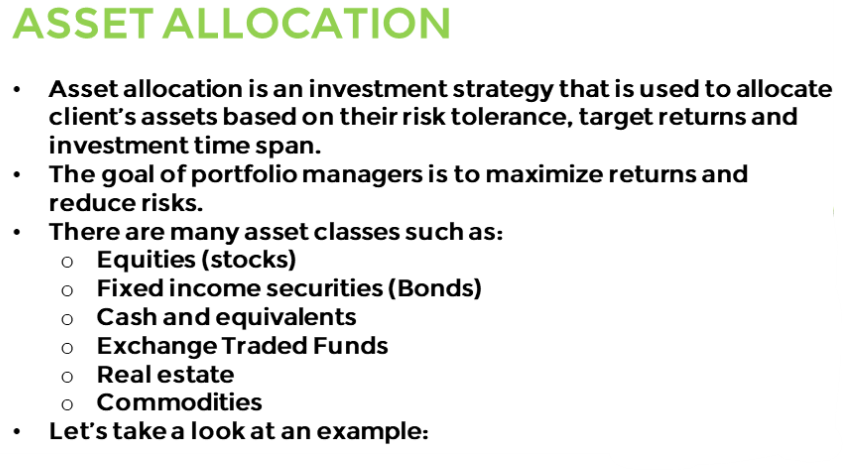
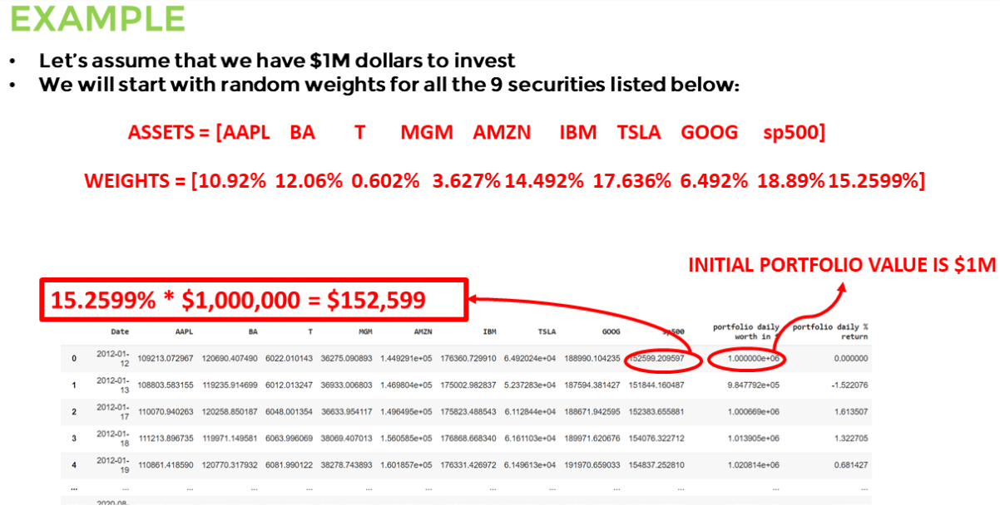
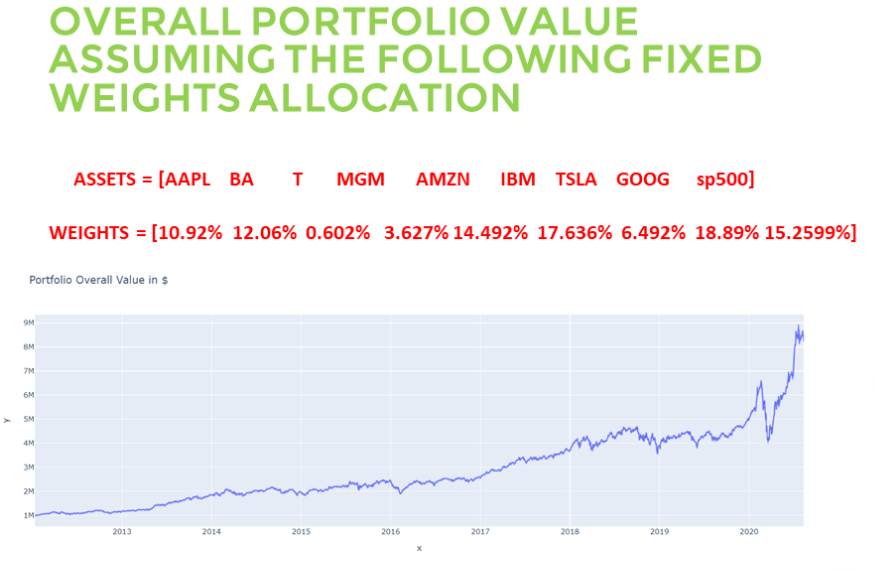

**What is the common advice that financial advisors generally recommend to retired seniors when it comes to asset allocations?**

The conventional wisdom is to subtract client's age from 100 to calculate the % of portolio that should be allocated to stocks

For Example: If you're 30 years old, you should have 70% allocated to stocks

If you are 75 years old, you should invest 25% in stocks (old retired seniors generally recommend a more stable low risk portfolio). 

## PERFORM RANDOM ASSET ALLOCATION AND CALCULATE PORTFOLIO DAILY RETURN

In [ ]:
# Let's create random portfolio weights
# Portfolio weights must sum to 1 

# Set random seed
# np.random.seed(101)
np.random.seed()

# Create random weights for the stocks and normalize them
weights = np.array(np.random.random(9))

# Ensure that the sum of all weights are = 1
weights = weights / np.sum(weights) 
print(weights)



[0.10840969 0.03055382 0.03958764 0.14601414 0.13245565 0.13777206
 0.14443767 0.14941387 0.11135547]


In [ ]:
# Normalize the stock avalues 
df_portfolio = normalize(stocks_df)
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2012-01-13,0.996251,0.987949,0.998340,1.018137,1.014153,0.992301,0.806726,0.992615,0.995052
2,2012-01-17,1.007855,0.996424,1.004316,1.009893,1.032570,0.996954,0.941593,0.998317,0.998587
3,2012-01-18,1.018320,0.994040,1.006972,1.049464,1.076792,1.002880,0.949027,1.005193,1.009680
4,2012-01-19,1.015093,1.000662,1.009960,1.055235,1.105269,0.999834,0.947257,1.015771,1.014666
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,7.313297,2.308039,0.991036,1.378401,18.217644,0.694821,52.567080,4.698347,2.568715
2155,2020-08-06,7.568452,2.280493,0.990704,1.521847,18.331155,0.698532,52.728494,4.782805,2.585226
2156,2020-08-07,7.383066,2.251622,0.996680,1.568838,18.004093,0.692107,51.423361,4.764919,2.586862
2157,2020-08-10,7.490377,2.375977,1.002656,1.784831,17.894390,0.704016,50.214865,4.770052,2.593956


In [ ]:
df_portfolio.columns[1:]

Index(['AAPL', 'BA', 'T', 'MGM', 'AMZN', 'IBM', 'TSLA', 'GOOG', 'sp500'], dtype='object')

In [ ]:
# Note that enumerate returns the value and a counter as well
for counter, stock in enumerate(df_portfolio.columns[1:]):
  df_portfolio[stock] = df_portfolio[stock] * weights[counter]
  df_portfolio[stock] = df_portfolio[stock] * 1000000
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,108409.689782,30553.821214,39587.636840,146014.144204,1.324556e+05,137772.057899,1.444377e+05,149413.866874,111355.468016
1,2012-01-13,108003.212221,30185.603775,39521.918999,148662.380950,1.343303e+05,136711.393155,1.165216e+05,148310.421048,110804.489756
2,2012-01-17,109261.246513,30444.568748,39758.498494,147458.636975,1.367697e+05,137352.367819,1.360015e+05,149162.331160,111198.173067
3,2012-01-18,110395.795274,30371.734849,39863.644936,153236.608056,1.426272e+05,138168.856680,1.370752e+05,150189.844895,112433.354478
4,2012-01-19,110045.909996,30574.051234,39981.934684,154079.228839,1.463991e+05,137749.166600,1.368195e+05,151770.266537,112988.624243
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,792832.220540,70519.398617,39232.766283,201265.980633,2.413030e+06,95726.967393,7.592666e+06,701998.125475,286040.438461
2155,2020-08-06,820493.528922,69677.761648,39219.622977,222211.125804,2.428065e+06,96238.228008,7.615981e+06,714617.423807,287879.019267
2156,2020-08-07,800395.888548,68795.665043,39456.202473,229072.490538,2.384744e+06,95353.065252,7.427470e+06,711944.939434,288061.255177
2157,2020-08-10,812029.482647,72595.166746,39692.783282,260610.570653,2.370213e+06,96993.664504,7.252918e+06,712711.904347,288851.182072


In [ ]:
# Let's create an additional column that contains the sum of all $ values in the portfolio
df_portfolio['portfolio daily worth in $'] = df_portfolio[df_portfolio != 'Date'].sum(axis = 1)
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,portfolio daily worth in $
0,2012-01-12,108409.689782,30553.821214,39587.636840,146014.144204,1.324556e+05,137772.057899,1.444377e+05,149413.866874,111355.468016,1.000000e+06
1,2012-01-13,108003.212221,30185.603775,39521.918999,148662.380950,1.343303e+05,136711.393155,1.165216e+05,148310.421048,110804.489756,9.730513e+05
2,2012-01-17,109261.246513,30444.568748,39758.498494,147458.636975,1.367697e+05,137352.367819,1.360015e+05,149162.331160,111198.173067,9.974070e+05
3,2012-01-18,110395.795274,30371.734849,39863.644936,153236.608056,1.426272e+05,138168.856680,1.370752e+05,150189.844895,112433.354478,1.014362e+06
4,2012-01-19,110045.909996,30574.051234,39981.934684,154079.228839,1.463991e+05,137749.166600,1.368195e+05,151770.266537,112988.624243,1.020408e+06
...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,792832.220540,70519.398617,39232.766283,201265.980633,2.413030e+06,95726.967393,7.592666e+06,701998.125475,286040.438461,1.219331e+07
2155,2020-08-06,820493.528922,69677.761648,39219.622977,222211.125804,2.428065e+06,96238.228008,7.615981e+06,714617.423807,287879.019267,1.229438e+07
2156,2020-08-07,800395.888548,68795.665043,39456.202473,229072.490538,2.384744e+06,95353.065252,7.427470e+06,711944.939434,288061.255177,1.204529e+07
2157,2020-08-10,812029.482647,72595.166746,39692.783282,260610.570653,2.370213e+06,96993.664504,7.252918e+06,712711.904347,288851.182072,1.190662e+07


In [ ]:
# Let's calculate the portfolio daily return 
# Define a new column in the dataframe and set it to zeros
df_portfolio['portfolio daily % return'] = 0.0000

for i in range(1, len(stocks_df)):
  # Calculate the percentage of change from the previous day
  df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['portfolio daily worth in $'][i] - df_portfolio['portfolio daily worth in $'][i-1]) / df_portfolio['portfolio daily worth in $'][i-1]) * 100 

df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,portfolio daily worth in $,portfolio daily % return
0,2012-01-12,108409.689782,30553.821214,39587.636840,146014.144204,1.324556e+05,137772.057899,1.444377e+05,149413.866874,111355.468016,1.000000e+06,0.000000
1,2012-01-13,108003.212221,30185.603775,39521.918999,148662.380950,1.343303e+05,136711.393155,1.165216e+05,148310.421048,110804.489756,9.730513e+05,-2.694866
2,2012-01-17,109261.246513,30444.568748,39758.498494,147458.636975,1.367697e+05,137352.367819,1.360015e+05,149162.331160,111198.173067,9.974070e+05,2.503020
3,2012-01-18,110395.795274,30371.734849,39863.644936,153236.608056,1.426272e+05,138168.856680,1.370752e+05,150189.844895,112433.354478,1.014362e+06,1.699926
4,2012-01-19,110045.909996,30574.051234,39981.934684,154079.228839,1.463991e+05,137749.166600,1.368195e+05,151770.266537,112988.624243,1.020408e+06,0.596007
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,792832.220540,70519.398617,39232.766283,201265.980633,2.413030e+06,95726.967393,7.592666e+06,701998.125475,286040.438461,1.219331e+07,0.426167
2155,2020-08-06,820493.528922,69677.761648,39219.622977,222211.125804,2.428065e+06,96238.228008,7.615981e+06,714617.423807,287879.019267,1.229438e+07,0.828899
2156,2020-08-07,800395.888548,68795.665043,39456.202473,229072.490538,2.384744e+06,95353.065252,7.427470e+06,711944.939434,288061.255177,1.204529e+07,-2.026037
2157,2020-08-10,812029.482647,72595.166746,39692.783282,260610.570653,2.370213e+06,96993.664504,7.252918e+06,712711.904347,288851.182072,1.190662e+07,-1.151304


## PORTFOLIO ALLOCATION - DAILY RETURN/WORTH CALCULATION (FUNCTION)

In [ ]:
# Lets assume we have $1,000,000 to be invested and we will allocate this fund based on the weights of the stocks
# We will create a function that takes in the stock prices along with the weights and retun:
# (1) Daily value of each individual securuty in $ over the specified time period
# (2) Overall daily worth of the entire portfolio 
# (3) Daily return 

def portfolio_allocation(df, weights):

  df_portfolio = df.copy()
  
  # Normalize the stock avalues 
  df_portfolio = normalize(df_portfolio)
  
  for counter, stock in enumerate(df_portfolio.columns[1:]):
    df_portfolio[stock] = df_portfolio[stock] * weights[counter]
    df_portfolio[stock] = df_portfolio[stock] * 1000000

  df_portfolio['portfolio daily worth in $'] = df_portfolio[df_portfolio != 'Date'].sum(axis = 1)
  
  df_portfolio['portfolio daily % return'] = 0.0000

  for i in range(1, len(stocks_df)):
    
    # Calculate the percentage of change from the previous day
    df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['portfolio daily worth in $'][i] - df_portfolio['portfolio daily worth in $'][i-1]) / df_portfolio['portfolio daily worth in $'][i-1]) * 100 
  
  # set the value of first row to zero, as previous value is not available
  df_portfolio['portfolio daily % return'][0] = 0
  return df_portfolio

## PERORM PORTFOLIO DATA VISUALIZATION

In [ ]:
# Plot the portfolio daily return
fig = px.line(x = df_portfolio.Date, y = df_portfolio['portfolio daily % return'], title = 'Portfolio Daily % Return')
fig.show()

In [ ]:
# Plot all stocks (normalized)
interactive_plot(df_portfolio.drop(['portfolio daily worth in $', 'portfolio daily % return'], axis = 1), 'Portfolio individual stocks worth in $ over time')

In [ ]:
# Print out a histogram of daily returns
fig = px.histogram(df_portfolio, x = 'portfolio daily % return')
fig.show()

In [ ]:
fig = px.line(x = df_portfolio.Date, y = df_portfolio['portfolio daily worth in $'], title= 'Portfolio Overall Value in $')
fig.show()

## UNDERSTAND PORTFOLIO STATISTICAL METRICS (CUMMULATIVE RETURN, AVERAGE DAILY RETURN, AND SHARPE RATIO)

### Daily Returns
***Stock daily return is a calculation of how much investors have gained or lost per day.***


\begin{align}
    Stock\,Daily\,Return = \frac{Closing\,Stock\,Price_t \,- \,Closing\,Stock \,Price_{t-1}}{Closing\,Stock\,Price_{t-1}}
\end{align}

### Cummulative Return
***Cumulative return is a measure of the aggregate amount that the stock gained or lost over a period of time.***

\begin{align}
    Stock\,Cummulative\,Return = \frac{Current\,Price\,Of\,Stock \,- \,Original Price\,Of\,Stock}{Original\,Price\,Of\,Stock}
\end{align}

### Standard Deviation (Risk/Volatility)

*   ***The standard deviation is a measurement of the dispersion away from the mean.***
*   ***The more spread the data is, the higher the standard deviation.***
*   ***Volatile stocks have high standard deviation and therefore standard deviation represent the risk associated with the security.***

\begin{align}
    Standard\,Deviation = \sqrt{\frac{\sum_{i=1}^n \,(x_i\,-\,\bar{x})^2}{n - 1}}
\end{align}

where: 

* x = Value of data with the index i 
* x = mean value 
* n = total number of data points in the data set

### Sharpe Ratio


*   ***Sharpe ratio is used by investors to calculate the return of an investment compared to its risk.***
*   Sharpe ratio is calculated as follows:

\begin{align}
    Sharpe\,Ratio = \frac{R_p \,- \,R_f}{\sigma_p}
\end{align}

*   ***Sharpe ratio is simply a calculation of the average return earned in excess of the risk free rate (U.S. government bonds) per unit of risk (volatility).***
*   ***Note that $R_f$, is the risk-free rate of return which is the
return on an investment with zero risk, meaning it's the return investors could expect for taking no risk.***
*   ***As Sharpe ratio increases, risk-adjusted return increases and security becomes more desired by investors.***



## CALCULATE PORTFOLIO STATISTICAL METRICS (CUMMULATIVE RETURN, AVERAGE DAILY RETURN, AND SHARPE RATIO)

In [ ]:
# Cummulative return of the portfolio (Note that we now look for the last net worth of the portfolio compared to it's start value)
cummulative_return = ((df_portfolio['portfolio daily worth in $'][-1:] - df_portfolio['portfolio daily worth in $'][0])/ df_portfolio['portfolio daily worth in $'][0]) * 100
print('Cummulative return of the portfolio is {} %'.format(cummulative_return.values[0]))


Cummulative return of the portfolio is 1059.416072625107 %


In [ ]:
# Calculate the portfolio standard deviation
print('Standard deviation of the portfolio is {}'.format(df_portfolio['portfolio daily % return'].std()))

Standard deviation of the portfolio is 1.7884063807869621


In [ ]:
# Calculate the average daily return 
print('Average daily return of the portfolio is {} %'.format(df_portfolio['portfolio daily % return'].mean() ))

Average daily return of the portfolio is 0.12958370691764912 %


In [ ]:
# Portfolio sharpe ratio
sharpe_ratio = df_portfolio['portfolio daily % return'].mean() / df_portfolio['portfolio daily % return'].std() * np.sqrt(252) 
#why 256? cuz for the annual daily sharpe  ratio (stocks active day).
print('Sharpe ratio of the portfolio is {}'.format(sharpe_ratio))
# more the better.

Sharpe ratio of the portfolio is 1.1502293868548445


# Portfolio Optimization _ Monte Carlo Simulations

In [ ]:
# Plot interactive chart
interactive_plot(stocks_df, 'Prices')

***If you want to create a portfolio to maximize cummulative returns with no regards of risk, what would the portfolio weights be based on the graph above?***

no, by the normalized graph. weights would be [1, 0, 0, 0, 0, 0, 0, 0, 0] 

***What would the cummulative return be?***

Cummulative return ~= 50x

In [ ]:
# Plot normalized interactive chart
interactive_plot(normalize(stocks_df), 'Normalized Prices')

## DEFINE PORTFOLIO ALLOCATION FUNCTION

In [ ]:
# Let's create random portfolio weights
# Portfolio weights must sum to 1 

# Set random seed
# np.random.seed(101)

# Create random weights for the stocks and normalize them
weights = np.array(np.random.random(9))

# Ensure that the sum of all weights are = 1
weights = weights / np.sum(weights) 
print(weights)


[0.09515328 0.17445787 0.13694668 0.0670513  0.01570873 0.08254487
 0.21430404 0.04869263 0.16514061]


In [ ]:
# Lets assume we have $1,000,000 to be invested and we will allocate this fund based on the weights of the stocks
# We will create a function that takes in the stock prices along with the weights and retun:
# (1) Daily value of each individual securuty in $ over the specified time period
# (2) Overall daily worth of the entire portfolio 
# (3) Daily return 

def portfolio_allocation(df, weights):

  df_portfolio = df.copy()
  
  # Normalize the stock avalues 
  df_portfolio = normalize(df_portfolio)
  
  for counter, stock in enumerate(df_portfolio.columns[1:]):
    df_portfolio[stock] = df_portfolio[stock] * weights[counter]
    df_portfolio[stock] = df_portfolio[stock] * 1000000

  df_portfolio['portfolio daily worth in $'] = df_portfolio[df_portfolio != 'Date'].sum(axis = 1)
  
  df_portfolio['portfolio daily % return'] = 0.0000

  for i in range(1, len(stocks_df)):
    
    # Calculate the percentage of change from the previous day
    df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['portfolio daily worth in $'][i] - df_portfolio['portfolio daily worth in $'][i-1]) / df_portfolio['portfolio daily worth in $'][i-1]) * 100 
  
  # set the value of first row to zero, as previous value is not available
  df_portfolio['portfolio daily % return'][0] = 0
  return df_portfolio

In [ ]:
# Get the portfolio allocation for the randomly selected weights
df_portfolio = portfolio_allocation(stocks_df, weights)
df_portfolio  

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,portfolio daily worth in $,portfolio daily % return
0,2012-01-12,95153.275248,174457.866229,136946.676509,67051.296894,15708.729066,82544.871923,2.143040e+05,48692.633152,165140.612757,1.000000e+06,0.000000
1,2012-01-13,94796.502055,172355.398319,136719.336849,68267.396260,15931.060764,81909.384316,1.728846e+05,48333.030098,164323.509752,9.555202e+05,-4.447981
2,2012-01-17,95900.703013,173834.050570,137537.743256,67714.623821,16220.359794,82293.418439,2.017872e+05,48610.659929,164907.343706,9.888061e+05,3.483534
3,2012-01-18,96896.518338,173418.179624,137901.479436,70367.931530,16915.033162,82782.610294,2.033802e+05,48945.517398,166739.122772,9.973466e+05,0.863722
4,2012-01-19,96589.417282,174573.376695,138310.682639,70754.872237,17362.373907,82531.156810,2.030009e+05,49460.562573,167562.590096,1.000146e+06,0.280680
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,695884.128612,402655.488633,135719.062353,92423.546332,286176.038075,57353.939424,1.126534e+07,228774.864824,424199.135637,1.358852e+07,0.131375
2155,2020-08-06,720162.992387,397849.864198,135673.595330,102041.786777,287959.149974,57660.256558,1.129993e+07,232887.380463,426925.758463,1.366109e+07,0.534025
2156,2020-08-07,702522.905876,392813.221143,136492.001737,105192.600737,282821.419518,57129.919366,1.102023e+07,232016.441883,427196.015059,1.335642e+07,-2.230213
2157,2020-08-10,712733.935754,414507.822130,137310.412689,119675.233120,281098.124726,58112.869445,1.076125e+07,232266.388838,428367.479863,1.314532e+07,-1.580497


In [ ]:
# Daily return of every stock in the portfolio (Note that we dropped the date, portfolio daily worth and daily % returns) 
# Note that we used pct.change() which calculates the percentage change between the current and a prior element.
# Note that 1 indicates one time period 

df_portfolio_daily_return = df_portfolio.drop(columns = ['Date', 'portfolio daily worth in $', 'portfolio daily % return'])
df_portfolio_daily_return = df_portfolio_daily_return.pct_change(1) 
df_portfolio_daily_return

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.003749,-0.012051,-0.001660,0.018137,0.014153,-0.007699,-0.193274,-0.007385,-0.004948
2,0.011648,0.008579,0.005986,-0.008097,0.018159,0.004689,0.167179,0.005744,0.003553
3,0.010384,-0.002392,0.002645,0.039184,0.042827,0.005944,0.007895,0.006889,0.011108
4,-0.003169,0.006661,0.002967,0.005499,0.026446,-0.003038,-0.001865,0.010523,0.004939
...,...,...,...,...,...,...,...,...,...
2154,0.003625,0.055794,-0.005332,0.000000,0.021091,-0.003099,-0.001332,0.005898,0.006430
2155,0.034889,-0.011935,-0.000335,0.104067,0.006231,0.005341,0.003071,0.017976,0.006428
2156,-0.024495,-0.012660,0.006032,0.030878,-0.017842,-0.009198,-0.024752,-0.003740,0.000633
2157,0.014535,0.055229,0.005996,0.137677,-0.006093,0.017206,-0.023501,0.001077,0.002742


In [ ]:
# Average/Std/min/max return for each individual stock in the portfolio
# MGM made 33% daily return in one day!!
df_portfolio_daily_return.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2158.000000,2158.000000,2158.000000,2158.000000,2158.000000,2158.000000,2158.000000,2158.000000,2158.000000
mean,0.001077,0.000659,0.000082,0.000647,0.001512,-0.000061,0.002385,0.000844,0.000493
std,0.017762,0.022603,0.012651,0.027472,0.019283,0.014313,0.034308,0.015859,0.010491
min,-0.128647,-0.238484,-0.092410,-0.336140,-0.109972,-0.128507,-0.193274,-0.111008,-0.119841
25%,-0.006925,-0.007842,-0.005498,-0.011112,-0.007590,-0.006265,-0.013953,-0.006147,-0.003189
50%,0.000833,0.000782,0.000595,0.001117,0.001166,0.000220,0.001168,0.000612,0.000594
75%,0.010019,0.009467,0.006324,0.012761,0.011050,0.006600,0.018008,0.008610,0.005021
max,0.119808,0.243186,0.100223,0.331148,0.157457,0.113011,0.243951,0.160524,0.093828


In [ ]:
# Obtain the expected portfolio return by multiplying the weights * average return of each security
portfolio_expected_return = np.sum(df_portfolio_daily_return.mean() * weights * 252)
portfolio_expected_return

0.23298778950949933

In [ ]:
# Calculate the porfolio Covariance which is the first step in calculating the portfolio volatility 
# Covariance determines the relationship between two stock prices movement.
# If two stocks have positive covariance, that means that their price moves together
# Covariance is crucial for asset pairing by selecting stocks with negative covariance values in order to reduce risk or volatility 
covariance = df_portfolio_daily_return.cov() * 252 # 252 to obtain the annualized covariance values
covariance

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
AAPL,0.079501,0.038976,0.019331,0.047229,0.035407,0.027839,0.044308,0.036140,0.030866
BA,0.038976,0.128750,0.028941,0.086728,0.029377,0.039074,0.049040,0.035054,0.038353
T,0.019331,0.028941,0.040335,0.029794,0.014333,0.022096,0.016682,0.017883,0.020652
MGM,0.047229,0.086728,0.029794,0.190191,0.041252,0.043761,0.074076,0.048215,0.045861
AMZN,0.035407,0.029377,0.014333,0.041252,0.093698,0.023619,0.051694,0.044333,0.027505
IBM,0.027839,0.039074,0.022096,0.043761,0.023619,0.051627,0.030394,0.026246,0.026637
TSLA,0.044308,0.049040,0.016682,0.074076,0.051694,0.030394,0.296617,0.044261,0.035184
GOOG,0.036140,0.035054,0.017883,0.048215,0.044333,0.026246,0.044261,0.063382,0.028702
sp500,0.030866,0.038353,0.020652,0.045861,0.027505,0.026637,0.035184,0.028702,0.027735


In [ ]:
# Calculate the Portfolio variance
variance = np.dot(weights.T, np.dot(covariance, weights))
variance

0.05217908900244294

In [ ]:
# Expected volatility in % format
print('Potfolio Variance = {:.2f}%'.format(variance * 100))

Potfolio Variance = 5.22%


In [ ]:
# Calculate the portfolio standard deviation (Expected volatility or dispertion away from the mean) which is the squareroot of its variance 
standard_deviation = np.sqrt(np.dot(weights.T, np.dot(covariance, weights)))
standard_deviation

0.22842742611701192

In [ ]:
# Expected volatility in % format
print('Potfolio standard deviation (volatility)) = {:.2f}%'.format(standard_deviation * 100))

Potfolio standard deviation (volatility)) = 22.84%


In [ ]:
# Portfolio sharpe ratio
# Standard deviation is the expected volatility
expected_volatility = standard_deviation

sharpe_ratio = portfolio_expected_return/expected_volatility 
sharpe_ratio

1.0199641674820228

## CALCULATE PORTFOLIO STATISTICAL ANALYSIS KEY METRICS (FUNCTION)

In [ ]:
# Let's put all of these statistical measures in one function!
def portfolio_statistical_analysis(weights):

  # Get the portfolio allocation for the specified weights (sent as arguments)
  df_portfolio = portfolio_allocation(stocks_df, weights)
  
  # Cummulative return of the portfolio (Note that we now look for the last net worth of the portfolio compared to it's start value)
  cummulative_return = ((df_portfolio['portfolio daily worth in $'][-1:] - df_portfolio['portfolio daily worth in $'][0])/ df_portfolio['portfolio daily worth in $'][0]) * 100
  
  # Daily change of every stock in the portfolio (Note that we dropped the date, portfolio daily worth and daily % returns) 
  df_portfolio_daily_return = df_portfolio.drop(columns = ['Date', 'portfolio daily worth in $', 'portfolio daily % return'])
  df_portfolio_daily_return = df_portfolio_daily_return.pct_change(1) 
  
  # Portfolio Expected Annual Return 
  expected_portfolio_return = np.sum(df_portfolio_daily_return.mean() * weights * 252)
  
  # Portfolio Expected Volatility
  covariance = df_portfolio_daily_return.cov() * 252 
  expected_volatility = np.sqrt(np.dot(weights.T, np.dot(covariance, weights)))
  
  # Portfolio sharpe ratio
  sharpe_ratio = expected_portfolio_return/expected_volatility 

  return cummulative_return.values[0], expected_portfolio_return, expected_volatility, sharpe_ratio
  

***Assume that we will allocate equal amount of money to all stocks (equal weights), what would the Sharpe ratio be? volatility? and Expected return?***



In [ ]:
# Ensure that the sum of all weights are = 1
weights = [1/9,1/9,1/9,1/9,1/9,1/9,1/9,1/9,1/9]
weights = np.array(weights)
print(weights)

[0.11111111 0.11111111 0.11111111 0.11111111 0.11111111 0.11111111
 0.11111111 0.11111111 0.11111111]


In [ ]:
statistical_metrics = portfolio_statistical_analysis(weights);
statistical_metrics # Tuple with all statistical measures

(862.0559887886882,
 0.21389589061774253,
 0.20998307961973936,
 1.0186339347203066)

In [ ]:
# Print out the statistical metrics
print('Portfolio Cummulative Return = {:.2f}%'.format(portfolio_statistical_analysis(weights)[0]))
print('Expected portfolio returns = {:.2f}%'.format(portfolio_statistical_analysis(weights)[1] * 100))
print('Expected volatility = {:.2f}%'.format(portfolio_statistical_analysis(weights)[2] * 100))
print('Sharpe Ratio = {:.2f}'.format(portfolio_statistical_analysis(weights)[3]))

Portfolio Cummulative Return = 862.06%
Expected portfolio returns = 21.39%
Expected volatility = 21.00%
Sharpe Ratio = 1.02


## PORTFOLIO OPTIMIZATION WITH RANDOM ALLOCATION USING MONTE CARLO SIMULATIONS

In [ ]:
# Create random weights and analayze the portfolio to find the optimal weight allocation

number_of_trials = 2000 # you will need more 

# Placeholder to store the weights
possible_weights_runs = np.zeros((number_of_trials, 9))

# Placeholder to store the sharpe ratios
sharpe_ratio_runs = np.zeros(number_of_trials)

# Placeholder to store the returns
expected_portfolio_returns_runs = np.zeros(number_of_trials)

# Placeholder to store the volatility
volatility_runs = np.zeros(number_of_trials)

# Placeholder to store the cummulative returns
cummulative_returns_runs = np.zeros(number_of_trials)

for i in tqdm(range(number_of_trials)):
    # Random Weights
    weights = np.array(np.random.random(9))
    weights = weights / np.sum(weights)
    
    # Store the weights
    possible_weights_runs[i,:] = weights
    
    # Store the sharpe ratio, return and volatility
    cummulative_returns_runs[i], expected_portfolio_returns_runs[i], volatility_runs[i], sharpe_ratio_runs[i]  = portfolio_statistical_analysis(weights)

  0%|          | 0/2000 [00:00<?, ?it/s]

In [ ]:
# A list of all possible Sharpe ratios (2000 runs)
print(sharpe_ratio_runs.shape)
print(sharpe_ratio_runs)

(2000,)
[0.90527768 1.08022375 1.10468422 ... 0.89992626 0.87296182 0.85810093]


In [ ]:
# A list of all possible portfolio expected returns (2000 runs)
expected_portfolio_returns_runs

array([0.19586622, 0.22372909, 0.24802071, ..., 0.1741697 , 0.20766033,
       0.18059235])

In [ ]:
# A list of all cummulative returns (2000 runs)
cummulative_returns_runs

array([ 578.59394341, 1165.63675286, 1210.61294333, ...,  471.22191809,
       1113.43386471,  547.17037742])

In [ ]:
# A list of all possible portfolio weights
possible_weights_runs

array([[0.05280295, 0.16079181, 0.13460842, ..., 0.03191986, 0.18823879,
        0.00697639],
       [0.00753845, 0.05130938, 0.14959863, ..., 0.16859187, 0.03112167,
        0.18796741],
       [0.1590135 , 0.01522135, 0.19467688, ..., 0.1846493 , 0.08148094,
        0.02651227],
       ...,
       [0.15588817, 0.0901497 , 0.10508645, ..., 0.03405768, 0.04706215,
        0.325633  ],
       [0.00263031, 0.11406997, 0.09493812, ..., 0.21303071, 0.09484342,
        0.07818222],
       [0.04583573, 0.04249885, 0.05831061, ..., 0.02488889, 0.07083475,
        0.20367855]])

***What is the best portfolio that maximizes Sharpe ratio?***

***What are the weights corresponding to this maximum Sharpe Ratio?***

In [ ]:
# Return the index of the maximum Sharpe ratio (Best run that maximizes return and reduces risk)
sharpe_ratio_runs.argmax()

303

In [ ]:
# Return the maximum Sharpe ratio
sharpe_ratio_runs.max()

1.323746657173723

In [ ]:
# Weights that corresponds to the maximum sharpe ratio (Golden set of weights!!)
possible_weights_runs[sharpe_ratio_runs.argmax(),:]

array([0.20481548, 0.033401  , 0.00030378, 0.02022166, 0.23875935,
       0.0993115 , 0.17593835, 0.11254007, 0.11470881])

In [ ]:
# Return the cummulative return, sharpe ratio, volatility corresponding to the best weights allocation (maximum Sharpe ratio)
optimal_cummulative_return, optimal_portfolio_return, optimal_volatility, optimal_sharpe_ratio = portfolio_statistical_analysis(possible_weights_runs[sharpe_ratio_runs.argmax(), :])

In [ ]:
print('Best Portfolio metrics based on {} Monte Carlo Simulation runs:'.format(number_of_trials))
print('  - Optimal Cummulative return of the portfolio = {}%'.format(optimal_cummulative_return))
print('  - Portfolio Expected return per year = {:.02f}%'.format(optimal_portfolio_return * 100))
print('  - Volatility of the portfolio = {:.02f}%'.format(optimal_volatility * 100))
print('  - Sharpe ratio of the portfolio = {}'.format(optimal_sharpe_ratio))

Best Portfolio metrics based on 2000 Monte Carlo Simulation runs:
  - Optimal Cummulative return of the portfolio = 1424.0834680292692%
  - Portfolio Expected return per year = 29.79%
  - Volatility of the portfolio = 22.50%
  - Sharpe ratio of the portfolio = 1.323746657173723


## PLOT THE OUTCOME OF ALL SIMULATION SCENARIOS

In [ ]:
# Create a DataFrame with all volatilties, portfolio returns, and sharpe ratios
df_optimize = pd.DataFrame({'Volatility': volatility_runs.tolist(), 'Portfolio_Return': expected_portfolio_returns_runs.tolist(), 'Sharpe_Ratio': sharpe_ratio_runs.tolist() })
df_optimize

,Volatility,Portfolio_Return,Sharpe_Ratio
0,0.216360,0.195866,0.905278
1,0.207114,0.223729,1.080224
2,0.224517,0.248021,1.104684
3,0.191230,0.188356,0.984972
4,0.204820,0.185210,0.904255
...,...,...,...
1995,0.234326,0.228159,0.973681
1996,0.203588,0.210169,1.032328
1997,0.193538,0.174170,0.899926
1998,0.237880,0.207660,0.872962


In [ ]:
# Plot interactive plot for volatility
fig = px.line(df_optimize, y = 'Volatility')
fig.show()

In [ ]:
# Plot interactive plot for Portfolio Return
fig = px.line(df_optimize, y = 'Portfolio_Return')
fig.update_traces(line_color='red')
fig.show()

In [ ]:
# Plot interactive plot for Portfolio Return
fig = px.line(df_optimize, y = 'Sharpe_Ratio')
fig.update_traces(line_color='purple')
fig.show()

In [ ]:
# Plot all the obtained volatility vs. returns 
# Highlight the volatility and return corresponding to highest sharpe ratio
fig = px.scatter(df_optimize, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )

# Let's add this line to highlight the point with the highest Sharpe Ratio
fig.add_trace(go.Scatter(x = [optimal_volatility], y = [optimal_portfolio_return], mode = 'markers', name = 'Optimal Point', marker = dict(size=[50], color = 'yellow')))

fig.update_layout(coloraxis_colorbar = dict(
    title = "Sharpe Ratio",
    thicknessmode = "pixels", thickness = 25,
    lenmode = "pixels",
    yanchor = "middle", y = 0.4,
    dtick = 5
))

fig.show()

## PORFOLIO OPTIMIZATION USING OPTIMIZERS

In [ ]:
# SciPy is an open-source ecosystems for mathematical calculations 
# We will minimize the cost function using Sequential Least Squares Programming (SLSQP)
# Check this out for more details: https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.minimize.html#scipy.optimize.minimize

from scipy.optimize import minimize

# Since optimization works as a minimizing function, we take negative of sharpe ratio and then try minimize it.

# Define a function that calculates the negative Sharpe ratio
def calculate_negative_sharpe_func(weights):
  cum_return, exp_portfolio_return, volatility, sharpe_ratio = portfolio_statistical_analysis(weights)
  return sharpe_ratio * -1

# Function to define optimization constraints (make sure sum of all weights add to 1)
def optimization_constraints_func(weights):
  return np.sum(weights) - 1

# Function to obtain the "volatility" for a given set of portfolio weights
def calculate_volatility_func(weights):
  cum_return, exp_portfolio_return, volatility, sharpe_ratio = portfolio_statistical_analysis(weights)
  return volatility

# Function to get the return for a particular weight
def calculate_return_func(weights):
  cum_return, exp_portfolio_return, volatility, sharpe_ratio = portfolio_statistical_analysis(weights)
  return exp_portfolio_return

In [ ]:
# Constraints to pass to the optimizer
optimization_constraint = ({'type':'eq','fun': optimization_constraints_func})

# Lower and upper bounds for weights you can change it
bounds = ((0, 1), (0, 1), (0, 1), (0, 1),(0, 1), (0, 1), (0, 1), (0, 1),(0,1))

# Initial weight assumption
initialization = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]

In [ ]:
# Optimization Function
# Optimization Algorithms is SLSQP stands for Sequential Least Squares Programming (SLSQP)   
optimization_results = minimize(calculate_negative_sharpe_func, initialization, method = 'SLSQP', bounds = bounds, constraints = optimization_constraint)

In [ ]:
optimized_weights = optimization_results.x
optimized_weights

array([2.58475028e-01, 4.89373446e-17, 5.47513919e-17, 5.60739097e-17,
       5.04003404e-01, 1.31670373e-16, 2.37521567e-01, 3.06943216e-17,
       2.91071303e-17])

In [ ]:
# Analyze the portfolio based on the obtained weights
cummulative_return_SLSQP, portfolio_return_value_SLSQP, vol_value_SLSQP, sharpe_ratio_SLSQP = portfolio_statistical_analysis(optimized_weights)

In [ ]:
print('Best Portfolio metrics based on SLSQP optimizer:')
print('  - Optimal Cummulative return of the portfolio = {}%'.format(cummulative_return_SLSQP))
print('  - Portfolio Expected return per year = {:.02f}%'.format(portfolio_return_value_SLSQP * 100))
print('  - Volatility of the portfolio = {:.02f}%'.format(vol_value_SLSQP * 100))
print('  - Sharpe ratio of the portfolio = {}'.format(sharpe_ratio_SLSQP))

Best Portfolio metrics based on SLSQP optimizer:
  - Optimal Cummulative return of the portfolio = 2125.9640944265357%
  - Portfolio Expected return per year = 40.50%
  - Volatility of the portfolio = 27.00%
  - Sharpe ratio of the portfolio = 1.4999984047118262


## PLOTTING MARKOWITZ EFFICIENT FRONTIER

In [ ]:
# The efficient frontier represents a set of portfolios that produces the highest return for any risk level 
# the efficient fronitier represents the portfolio with the least amount of risk (volatility)(x-axis) for any given expected return (y-axis)
# The returns range from 0 to 0.35 so we will obtain x number of y-positions (x = 50) to calculate the optimal volatility for that return
frontier_y = np.linspace(0, 0.35, 50)

In [ ]:
frontier_volatility = []

# Calculate the optimal volatility for each return
for possible_return in frontier_y:

    # Conditions for optimization
    condition = ({'type':'eq', 'fun': optimization_constraints_func},
                 {'type':'eq', 'fun': lambda w: calculate_return_func(w) - possible_return})
    
    result = minimize(calculate_volatility_func, initialization, method = 'SLSQP', bounds = bounds, constraints = condition)
    
    frontier_volatility.append(result['fun'])

In [ ]:
# Plot the efficient frontier
fig = px.scatter(df_optimize, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio' )
fig.add_trace(go.Scatter(x = frontier_volatility, y = frontier_y.tolist(), name = 'Frontier'))
# fig.add_trace(go.Scatter(x = [vol_value], y = [portfolio_return_value], mode = 'markers', name = 'Optimal Point', marker_color = 'black'))
fig.show()

# BEHIND CAPITAL ASSET PRICING MODEL (CAPM)

## WHAT IS CAPM?
***Capital Assets Pricing Model (CAPM) is one of the most important models in Finance.***

***CAPM is a model that describes the relationship between the expected return and risk of securities.***

***CAPM indicates that the expected return on a security is equal to the risk-free return plus a risk premium.***

## RISK FREE ASSET ($r_p$)

*   ***CAPM assumes that there exist a risk free asset with zero
standard deviation.***
*   ***The risk free asset return is denoted as $r_f$.***
*   ***Investors who are extremely risk averse would prefer to buy the risk free asset to protect their money and earn a low return $r_f$***
*   ***If investors are interested in gaining more return, they have to bear more risk compared to the risk free asset.***
*   ***A risk free asset could be a U.S. government 10 year Treasury bill. This is technically a risk free asset since it's backed by the US Government.***



## MARKET PORTFOLIO ($r_m$)
*   ***Market portfolio includes all securities in the market. A good representation of the market portfolio is the S&P500 (Standard & Poor's 500 Index).***
*   ***The market overall return is denoted as $r_m$.***
*   ***The S&P500 is a market-capitalization-weighted index of the 500 largest U.S. publicly traded companies.***
*   ***The index is viewed as a gauge of large-cap U.S. equities.***



## WHAT IS BETA?
Let's compare the market portfolio (S&P500) with other stocks
during the recession of 2020.

On March 16, 2020 the S&P 500 experienced a drop of -11.9%
while AT&T only dropped -7.7% and Boeing dropped -23.8%. AT&T was less volatile compared to the market. However, Boeing was more volatile compared to the market.

* ***Beta represents the slope of the line regression line(market return vs. stock return).*** 
* ***Beta is a measure of the volatility or systematic risk of a security or portfolio compared to the entire market (S&P500).***
* ***Beta is used in the CAPM and describes the relationship between systematic risk and expected return for assets.***
* ***Tech stocks generally have higher betas than S&P500 but they also have excess returns.***
 *  ***Beta=1.0, this indicates that its price activity is strongly correlated with the market.***
 * ***Beta<1(defensive):indicates that the security is theoretically less volatile than the market (Ex:Utility and consumer goods (P&G). If the stock is included, this will make the portfolio less risky compared to the same portfolio without the stock.***
 * ***Beta>1 (aggressive): indicates that the security's priceis more volatile than the market. For instance, Tesla stock beta is 1.26 indicating that it's 26% more volatile than the market. It will do better if the economy is booming and worse in cases of recession.***


## CAPM FORMULA

\begin{align}
    r_i = r_f \,+ \,B_i(r_m\,-\,r_f)
\end{align}

Where:

* $r_i$ EXPECTED RETURN OF A SECURITY
* $r_f$ RISK FREE RATE OF RETURN
* $B_i$ BETA BETWEEN THE STOCK AND THE MARKET
* $(r_m\,-\,r_f)$ RISK PREMIUM (INCENTIVE FOR INVESTING IN A RISKY SECURITY)

### example
The CAPM formula for Apple Stock can be calculated as follows:
* $r_f$ = 0% (yield from a 10 years US government bond could also be used)
* $r_m$ = 12.4% (S&P500 rate of return)
* $B_{APPL}$ = 1.11

\begin{align}
    r_{APPL} = r_f \,+ \,B_{APPL}(r_m\,-\,r_f)
\end{align}

Expected return for Apple stock = $r_{appL}$ = 0% + 1.11(12.4% - 0%) = 13.7%

$r_{APLL}$ = 13.7%

**"If an investor intends to invest in Apple stock, he/she should expect 13.7% return in order to be compensated for the risk they are taking"**

## CALCULATE BETA FOR A SINGLE STOCK

In [ ]:
# Select any stock, let's say Apple 
stocks_daily_return['AAPL']

0       0.000000
1      -0.374946
2       1.164812
3       1.038382
4      -0.316937
          ...   
2154    0.362467
2155    3.488923
2156   -2.449458
2157    1.453480
2158   -2.973987
Name: AAPL, Length: 2159, dtype: float64

In [ ]:
# Select the S&P500 (Market)
stocks_daily_return['sp500']

0       0.000000
1      -0.494792
2       0.355295
3       1.110793
4       0.493866
          ...   
2154    0.642974
2155    0.642770
2156    0.063303
2157    0.274222
2158   -0.796913
Name: sp500, Length: 2159, dtype: float64

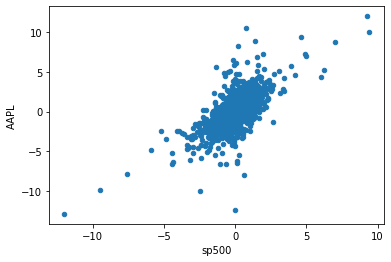

In [ ]:
# plot a scatter plot between the selected stock and the S&P500 (Market)
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'AAPL')

In [ ]:
# Fit a polynomial between the selected stock and the S&P500 (Poly with order = 1 is a straight line)

# beta represents the slope of the line regression line (market return vs. stock return). 
# Beta is a measure of the volatility or systematic risk of a security or portfolio compared to the entire market (S&P500) 
# Beta is used in the CAPM and describes the relationship between systematic risk and expected return for assets 

# Beta = 1.0, this indicates that its price activity is strongly correlated with the market. 
# Beta < 1, indicates that the security is theoretically less volatile than the market (Ex: Utility stocks). If the stock is included, this will make the portfolio less risky compared to the same portfolio without the stock.
# Beta > 1, indicates that the security's price is more volatile than the market. For instance, Tesla stock beta is 1.26 indicating that it's 26% more volatile than the market. 
# Tech stocks generally have higher betas than S&P500 but they also have excess returns
# MGM is 65% more volatile than the S&P500!


beta, alpha = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return['AAPL'], 1)
print('Beta for {} stock is = {} and alpha is = {}'.format('AAPL', beta, alpha))  

Beta for AAPL stock is = 1.1128924148678097 and alpha is = 0.052812084694402905


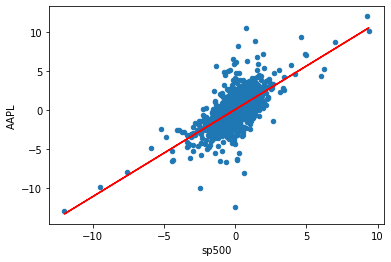

In [ ]:
# Now let's plot the scatter plot and the straight line on one plot
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'AAPL')

# Straight line equation with alpha and beta parameters 
# Straight line equation is y = beta * rm + alpha
plt.plot(stocks_daily_return['sp500'], beta * stocks_daily_return['sp500'] + alpha, '-', color = 'r')


## APPLY THE CAPM FORMULA TO AN INDIVIDUAL STOCK

In [ ]:
# Let's calculate the annualized rate of return for S&P500 
# Note that out of 365 days/year, stock exchanges are closed for 104 days during weekend days (Saturday and Sunday) 
# Check your answers with: https://dqydj.com/sp-500-return-calculator/
rm = stocks_daily_return['sp500'].mean() * 252
rm

12.42763366329808

In [ ]:
# Assume risk free rate is zero
# Also you can use the yield of a 10-years U.S. Government bond as a risk free rate
rf = 0 

# Calculate return for any security (APPL) using CAPM  
ER_AAPL = rf + ( beta * (rm-rf) ) 

In [ ]:
ER_AAPL

13.830619238640283

## CALCULATE BETA FOR ALL STOCKS

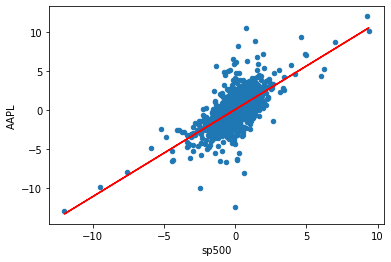

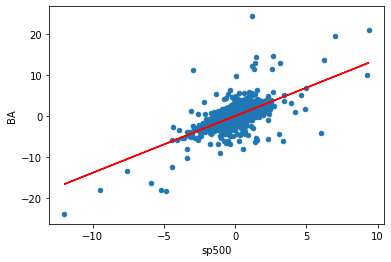

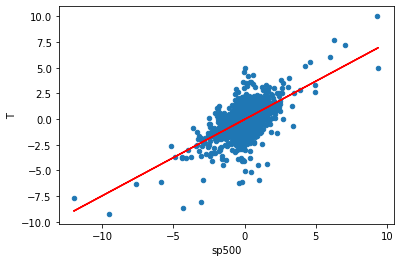

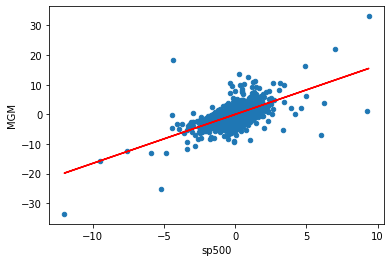

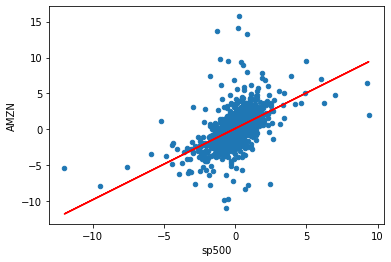

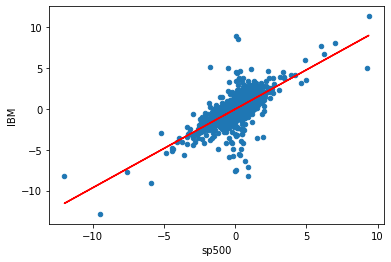

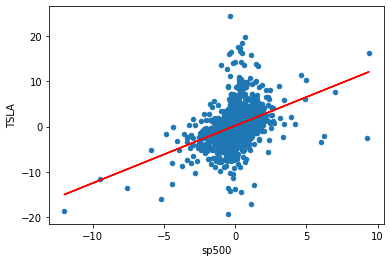

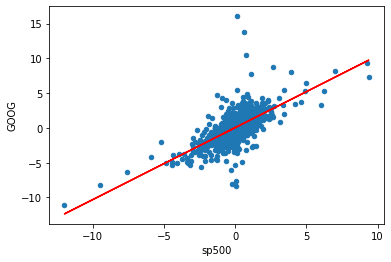

In [ ]:
# Let's create a placeholder for all betas and alphas (empty dictionaries)
beta = {}
alpha = {}

# Loop on every stock daily return
for i in stocks_daily_return.columns:

  # Ignoring the date and S&P500 Columns 
  if i != 'Date' and i != 'sp500':
    # plot a scatter plot between each individual stock and the S&P500 (Market)
    stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = i)
    
    # Fit a polynomial between each stock and the S&P500 (Poly with order = 1 is a straight line)
    b, a = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return[i], 1)
    
    plt.plot(stocks_daily_return['sp500'], b * stocks_daily_return['sp500'] + a, '-', color = 'r')
    
    beta[i] = b
    
    alpha[i] = a
    
    plt.show()

interactive plot

In [ ]:
# Let's do the same plots but in an interactive way
# Explore some wierd points in the dataset: Tesla stock return was at 24% when the S&P500 return was -0.3%!

for i in stocks_daily_return.columns:
  
  if i != 'Date' and i != 'sp500':
    
    # Use plotly express to plot the scatter plot for every stock vs. the S&P500
    fig = px.scatter(stocks_daily_return, x = 'sp500', y = i, title = i)

    # Fit a straight line to the data and obtain beta and alpha
    b, a = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return[i], 1)
    
    # Plot the straight line 
    fig.add_scatter(x = stocks_daily_return['sp500'], y = b*stocks_daily_return['sp500'] + a)
    fig.show()

In [ ]:
# Let's view Beta for every stock 
beta

{'AAPL': 1.1128924148678097,
 'AMZN': 0.9917345712576846,
 'BA': 1.3828672010892775,
 'GOOG': 1.0348817687428562,
 'IBM': 0.9604149148095246,
 'MGM': 1.653567706518011,
 'T': 0.7446293454747844,
 'TSLA': 1.2686150101095903}

In [ ]:
# Let's view alpha for each of the stocks
# Alpha describes the strategy's ability to beat the market (S&P500)
# Alpha indicates the “excess return” or “abnormal rate of return,” 
# A positive 0.175 alpha for Tesla means that the portfolio’s return exceeded the benchmark S&P500 index by 17%.

alpha

{'AAPL': 0.052812084694402905,
 'AMZN': 0.1022139641776522,
 'BA': -0.0022906983297531543,
 'GOOG': 0.03335558721467016,
 'IBM': -0.05345494150445116,
 'MGM': -0.016885305520478674,
 'T': -0.028563430198461616,
 'TSLA': 0.17583492165165812}

## APPLY CAPM FORMULA TO CALCULATE THE RETURN FOR THE PORTFOLIO

In [ ]:
# Obtain a list of all stock names
keys = list(beta.keys())
keys

['AAPL', 'BA', 'T', 'MGM', 'AMZN', 'IBM', 'TSLA', 'GOOG']

In [ ]:
# Define the expected return dictionary
ER = {}

rf = 0 # assume risk free rate is zero in this case
rm = stocks_daily_return['sp500'].mean() * 252 # this is the expected return of the market 
rm

12.42763366329808

In [ ]:
for i in tqdm(keys):
  # Calculate return for every security using CAPM  
  ER[i] = rf + ( beta[i] * (rm-rf) ) 

  0%|          | 0/8 [00:00<?, ?it/s]

In [ ]:
for i in keys:
  print('Expected Return Based on CAPM for {} is {}%'.format(i, ER[i]))

Expected Return Based on CAPM for AAPL is 13.830619238640283%
Expected Return Based on CAPM for BA is 17.1857669801279%
Expected Return Based on CAPM for T is 9.253980720502046%
Expected Return Based on CAPM for MGM is 20.54993369406583%
Expected Return Based on CAPM for AMZN is 12.324913942818489%
Expected Return Based on CAPM for IBM is 11.935684726020405%
Expected Return Based on CAPM for TSLA is 15.765882605403178%
Expected Return Based on CAPM for GOOG is 12.861131506762177%


In [ ]:
# Assume equal weights in the portfolio
portfolio_weights = 1/8 * np.ones(8) 
portfolio_weights

array([0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125])

In [ ]:
# Calculate the portfolio return 
ER_portfolio = sum(list(ER.values()) * portfolio_weights)
ER_portfolio

14.213489176792537

In [ ]:
print('Expected Return Based on CAPM for the portfolio is {}%\n'.format(ER_portfolio))

Expected Return Based on CAPM for the portfolio is 14.213489176792537%



# Trading Using Moving Average

## CALCULATE AND VISUALIZE MOVING AVERAGE

In [ ]:
# visualize the original stock price data, you can select which stocks you are interested in by changing the df.columns index 
for i in stocks_df.columns[1:]:
  fig = px.line(x = stocks_df.Date, y = stocks_df[i], title = i + ' price')
  fig.show()

In [ ]:
# copy the original dataframe to a new dataframe
moving_average_df = copy(stocks_df)

In [ ]:
# Create a moving average with 21 days window
# This is done by creating a loop through each stock & calculate the average using rolling(21)
# Note that the first 20 days shows NaN since we do not have data available
for i in stocks_df.columns[1:]:
  moving_average_df[i] = stocks_df[i].rolling(21).mean()

# View the first 30 elements
moving_average_df.head(30)

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2012-01-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2012-01-17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2012-01-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2012-01-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2012-01-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2012-01-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2012-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2012-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2012-01-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Create a moving average plot
for i in stocks_df.columns[1:]:
  fig = px.line(x = moving_average_df.Date[20:], y = moving_average_df[i][20:], title= i + ' 21-days moving average')
  fig.show()

In [ ]:
# Overlay the 21-days moving average plot on top of stock original prices (without any averaging)
for i in stocks_df.columns[1:]:  
  fig = px.line(x = stocks_df.Date[20:], y = stocks_df[i][20:], title =  i + ' Original Stock Price vs. 21-days Moving Average change')
  fig.add_scatter(x = moving_average_df.Date[20:], y = moving_average_df[i][20:], name = '21-days moving average')
  fig.show()

## GENERATE BUY/SELL SIGNALS USING MOVING AVERAGE

In [ ]:
# create a signal dataframe 
# copy the dataframe
signals_df = copy(stocks_df)

In [ ]:
# logic to create buy (1) and sell (-1) signal
# if price is above the moving average, we buy since the trend is up
# if the price is below the moving average, we sell since the trend is down
# The moving average is a technical stock analysis tool that works by smoothing out price data or noise due to random short-term price fluctuations.
# As you increase the averaging window (look back window), the curve tend to become more smoother

# Loop on rows starting from row 21
for i in range(21, len(stocks_df)):

  # Loop on Columns (stock names)
  for j in stocks_df.columns[1:]:
    
    # Compare original stock data with the average 
    if  stocks_df[j][i] > moving_average_df[j][i]:
      signals_df[j][i] = 1

    elif  stocks_df[j][i] < moving_average_df[j][i]:
      signals_df[j][i] = -1
    
    else:
      signals_df[j][i] = 0

In [ ]:
# Signal values (Buy/Sell decision table)
signals_df[21:]

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
21,2012-02-13,1.0,-1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
22,2012-02-14,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
23,2012-02-15,1.0,-1.0,-1.0,1.0,-1.0,1.0,1.0,1.0,1.0
24,2012-02-16,1.0,-1.0,1.0,1.0,-1.0,1.0,1.0,1.0,1.0
25,2012-02-17,1.0,1.0,1.0,1.0,-1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,1.0,1.0,-1.0,1.0,1.0,1.0,-1.0,-1.0,1.0
2155,2020-08-06,1.0,-1.0,-1.0,1.0,1.0,1.0,-1.0,-1.0,1.0
2156,2020-08-07,1.0,-1.0,1.0,1.0,1.0,1.0,-1.0,-1.0,1.0
2157,2020-08-10,1.0,1.0,1.0,1.0,1.0,1.0,-1.0,-1.0,1.0


## EXECUTE A TRADE USING MOVING AVERAGE

In [ ]:
# Function to simulate a trade
# Note: We assume we started trading with $1M in assets
# Note: We don't want to spend more than 10% of the principal amount ($1M) on any specific stock so we restrict the buying amount to be 100,000.
# Note: We do not re-investing the profit to buy more stocks

def trade(signals_df):
  
  # create a dictionary to hold the number of stocks that we are buying
  buy = {}

  # list to store the profit/loss values over the trading time period
  profit_loss_change = []
  
  # list to store the dates in which profit/loss values were added to the list above
  date = []
  
  # Assign 0 to all stocks in the dictionary
  for i in stocks_df.columns[1:]:
    buy[i] = 0

  # Start with a principal amount of $1M
  amount = 1000000
  
  # placeholder to track profits & losses
  profit_loss_tracker = {'pl': 0}
  
  # loop through all rows in the dataframe 
  for i in range(len(stocks_df)-1):
    
    # for each index, we loop through the all available stocks to get the signal
    for j in stocks_df.columns[1:]:
      
      # BUY SIGNALS
      # if the signal is buy (1), we pass through this:
      if signals_df[j][i] == 1:
        
        # Since we don't want to spend more than 10% of the principal amount ($1M) on one specific stock,
        # we restrict the buying amount to be $100,000. 
        # Hence, we check if (1) we have funds over $99,999 and (2) don't own this specific stock at the moment (i.e.: buy[j] == 0)
        if amount > 99999 and buy[j] == 0:
          
          # Since signal is generated based on the closing stock price, we buy based on the next day price (df[j][i+1])
          # Let's calculate the number of stock units that we are buying
          # Number of stock units = Max funds(Balance)/next day price
          units = 100000/stocks_df[j][i+1]
          
          # Reduce the amount spent to buy the stock i.e.: $100,000 from the principal amount
          amount = amount - 100000

          # Add the number of units bought to the acquired stocks dictionary
          buy[j] = units

      # SELL SIGNALS  
      # Check the sell signal and also make sure we own the stock that we want to sell
      elif signals_df[j][i] == -1 and buy[j] > 0:
          
          # We sell the stock based on next day price and calculate the profit or loss
          change = (buy[j] * stocks_df[j][i+1]) - 100000
          
          # Change the number of units owned to 0 because we already sold them
          buy[j] = 0
          
          # We are not re-investing profit, we take out the profit and only add 100,000 to the
          # principal if we have profit, in case we incur loss we remove the loss from the principal
          amount = amount + min(100000, 100000 + change)
          
          # Add the profit/loss to the dictionary
          profit_loss_tracker['pl'] = profit_loss_tracker['pl'] + change
          
          # Append the p/l value to the list
          profit_loss_change.append(profit_loss_tracker['pl'])
          
          # Append the date to the list
          date.append(stocks_df['Date'][i])

  return profit_loss_change, date, buy


In [ ]:
# Call the trading function and pass the signals dataframe as an argument
profit_loss_change, trade_date, buy = trade(signals_df)

In [ ]:
# Plot the net Profit/Loss
fig = px.line(x = trade_date, y = profit_loss_change, title = 'p/l')
fig.show()

## TECHNICAL ANALYSIS WITH MOMENTUM

In [ ]:
# Copy the dataframe
df_change  = copy(stocks_df)

In [ ]:
# Loop through each stock
for i in stocks_df.columns[1:]:

  # Loop through each row belonging to the stock
  for j in range(1, len(stocks_df)):
    
    # Calculate the percentage of change from the previous day (note that we obtained the log change)
    df_change[i][j] = ((np.log(stocks_df[i][j])- np.log(stocks_df[i][j-1])))
  
  # set the value of first row to zero, as previous value is not available
  df_change[i][0] = 0

In [ ]:
df_change

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.003757,-0.012125,-0.001661,0.017974,0.014054,-0.007728,-0.214772,-0.007413,-0.004960
2,2012-01-17,0.011581,0.008542,0.005968,-0.008130,0.017997,0.004678,0.154589,0.005728,0.003547
3,2012-01-18,0.010330,-0.002395,0.002641,0.038435,0.041936,0.005927,0.007864,0.006865,0.011047
4,2012-01-19,-0.003174,0.006639,0.002963,0.005484,0.026103,-0.003042,-0.001867,0.010468,0.004927
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.003618,0.054294,-0.005346,0.000000,0.020871,-0.003104,-0.001332,0.005880,0.006409
2155,2020-08-06,0.034294,-0.012007,-0.000335,0.099001,0.006211,0.005327,0.003066,0.017817,0.006407
2156,2020-08-07,-0.024800,-0.012740,0.006014,0.030411,-0.018003,-0.009240,-0.025063,-0.003747,0.000633
2157,2020-08-10,0.014430,0.053758,0.005978,0.128989,-0.006112,0.017059,-0.023781,0.001077,0.002738


In [ ]:
# Statistical information
df_change.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000
mean,0.000919,0.000403,0.000001,0.000265,0.001326,-0.000164,0.001799,0.000719,0.000438
std,0.017780,0.022699,0.012698,0.027769,0.019170,0.014377,0.034098,0.015789,0.010532
min,-0.137708,-0.272444,-0.096963,-0.409684,-0.116503,-0.137548,-0.214772,-0.117667,-0.127652
25%,-0.006948,-0.007872,-0.005511,-0.011159,-0.007618,-0.006282,-0.014051,-0.006157,-0.003191
50%,0.000811,0.000780,0.000595,0.001083,0.001162,0.000213,0.001164,0.000603,0.000593
75%,0.009969,0.009421,0.006304,0.012680,0.010973,0.006578,0.017835,0.008572,0.005007
max,0.113157,0.217677,0.095513,0.286041,0.146225,0.107069,0.218292,0.148872,0.089683


In [ ]:
# plot the returns based on consecutive days

for i in stocks_df.columns[1:]:
  fig1 = px.line(x = df_change.Date, y = df_change[i], title = i + ' change')
  fig1.show()

In [ ]:
# Plot the original stock price, the 21-days moving average and the daily change 

for i in stocks_df.columns[1:]:
  # fig = make_subplots(rows=2, cols=1)
  fig = px.line(x = stocks_df.Date[20:], y = stocks_df[i][20:], title= i + ' average change')
  fig.add_scatter(x = moving_average_df.Date[20:], y = moving_average_df[i][20:], name='21 Day Moving Average')
  fig2 = px.line(x = df_change.Date[20:], y = df_change[i][20:], title= i + ' average change')
  fig.show() 
  fig2.show()


In [ ]:
# Signal to buy and sell, if the return moving average changes from 0 to +ve and price is above the moving average we buy. 
# If the return moving average is moving from 0.5 to less than that and price is less than the moving average we sell
# also when return moving average changes from +ve to -ve we sell
for i in range(25, len(stocks_df)):
  for j in stocks_df.columns[1:]:
    
    if df_change[j][i] > 0 and df_change[j][i-1] < 0 and stocks_df[j][i] > moving_average_df[j][i]:
      signals_df[j][i] = 1
    
    elif df_change[j][i-1] > 0.05 and df_change[j][i] < 0.05 and stocks_df[j][i] < moving_average_df[j][i]:
      signals_df[j][i] = -1
    
    elif df_change[j][i-1] > 0 and df_change[j][i] < 0:
      signals_df[j][i] = -1
    
    else:
      signals_df[j][i] = 0

In [ ]:
# Do the trade using the new signal table
pl_change, id, buy = trade(signals_df)

In [ ]:
fig = px.line(x = id, y = pl_change, title = 'p/l')
fig.show()

In [ ]:
a = pd.DataFrame({'return': pl_change})
a = a['return'].diff()
sharpe_ratio = a.mean()/a.std() * np.sqrt(252)
portfolio_return = np.sum(a.mean()) * 252 / 1000000
print("Annual rate of return : {}%".format(portfolio_return))
print("Sharpe ratio for the model is {}".format(sharpe_ratio))

Annual rate of return : 0.02901896833124455%
Sharpe ratio for the model is 0.7949383237930704


# Stock Price Predictions Using regression / LSTM

## IMPORT DATASETS AND LIBRARIES


In [1]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
import plotly.express as px
from copy import copy
from scipy import stats
import matplotlib.pyplot as plt
import numpy as np
import plotly.figure_factory as ff
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from tensorflow import keras

In [3]:
# Read stock prices data
stock_price_df = pd.read_csv('/content/drive/MyDrive/my files/Financial Analysis/stock.csv')
stock_price_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [4]:
# Read the stocks volume data
stock_vol_df = pd.read_csv("/content/drive/MyDrive/my files/Financial Analysis/stock_volume.csv")
stock_vol_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,53146800,3934500,26511100,17891100,5385800,6881000,729300,3764400,4019890000
1,2012-01-13,56505400,4641100,22096800,16621800,4753500,5279200,5500400,4631800,3692370000
2,2012-01-17,60724300,3700100,23500200,15480800,5644500,6003400,4651600,3832800,4010490000
3,2012-01-18,69197800,4189500,22015000,18387600,7473500,4600600,1260200,5544000,4096160000
4,2012-01-19,65434600,5397300,25524000,14022900,7096000,8567200,1246300,12657800,4465890000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,30498000,46551000,22991700,18914200,3930000,3675400,4978000,1979500,4732220000
2155,2020-08-06,50607200,32921600,21908700,35867700,3940600,3417100,5992300,1995400,4267490000
2156,2020-08-07,49453300,19301600,30398500,34530300,3929600,3651000,8883500,1576600,4104860000
2157,2020-08-10,53100900,35857700,35514400,71219700,3167300,3968300,7522300,1289300,4318570000


In [5]:
# Sort the data based on Date
stock_price_df = stock_price_df.sort_values(by = ['Date'])
stock_price_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [6]:
# Sort the data based on Date
stock_vol_df = stock_vol_df.sort_values(by = ['Date'])
stock_vol_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,53146800,3934500,26511100,17891100,5385800,6881000,729300,3764400,4019890000
1,2012-01-13,56505400,4641100,22096800,16621800,4753500,5279200,5500400,4631800,3692370000
2,2012-01-17,60724300,3700100,23500200,15480800,5644500,6003400,4651600,3832800,4010490000
3,2012-01-18,69197800,4189500,22015000,18387600,7473500,4600600,1260200,5544000,4096160000
4,2012-01-19,65434600,5397300,25524000,14022900,7096000,8567200,1246300,12657800,4465890000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,30498000,46551000,22991700,18914200,3930000,3675400,4978000,1979500,4732220000
2155,2020-08-06,50607200,32921600,21908700,35867700,3940600,3417100,5992300,1995400,4267490000
2156,2020-08-07,49453300,19301600,30398500,34530300,3929600,3651000,8883500,1576600,4104860000
2157,2020-08-10,53100900,35857700,35514400,71219700,3167300,3968300,7522300,1289300,4318570000


In [7]:
# Check if Null values exist in stock prices data
stock_price_df.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [8]:
# Check if Null values exist in stocks volume data
stock_vol_df.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [9]:
# Get stock prices dataframe info
stock_price_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2159 non-null   object 
 1   AAPL    2159 non-null   float64
 2   BA      2159 non-null   float64
 3   T       2159 non-null   float64
 4   MGM     2159 non-null   float64
 5   AMZN    2159 non-null   float64
 6   IBM     2159 non-null   float64
 7   TSLA    2159 non-null   float64
 8   GOOG    2159 non-null   float64
 9   sp500   2159 non-null   float64
dtypes: float64(9), object(1)
memory usage: 185.5+ KB


In [10]:
# Get stock volume dataframe info
stock_vol_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Date    2159 non-null   object
 1   AAPL    2159 non-null   int64 
 2   BA      2159 non-null   int64 
 3   T       2159 non-null   int64 
 4   MGM     2159 non-null   int64 
 5   AMZN    2159 non-null   int64 
 6   IBM     2159 non-null   int64 
 7   TSLA    2159 non-null   int64 
 8   GOOG    2159 non-null   int64 
 9   sp500   2159 non-null   int64 
dtypes: int64(9), object(1)
memory usage: 185.5+ KB


In [11]:
stock_vol_df.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03
mean,5.820332e+07,6.419916e+06,2.832131e+07,9.845582e+06,4.102673e+06,4.453090e+06,7.001302e+06,2.498238e+06,3.680732e+09
std,4.568141e+07,9.711873e+06,1.428911e+07,7.295753e+06,2.290722e+06,2.462811e+06,5.781208e+06,1.928407e+06,8.622717e+08
min,1.136200e+07,7.889000e+05,6.862400e+06,9.507000e+05,8.813000e+05,1.193000e+06,3.649000e+05,7.900000e+03,1.248960e+09
25%,2.769930e+07,3.031850e+06,2.002150e+07,5.796450e+06,2.675700e+06,3.111250e+06,3.433450e+06,1.325400e+06,3.211890e+09
50%,4.209420e+07,3.991000e+06,2.485930e+07,7.899800e+06,3.494800e+06,3.825000e+06,5.581100e+06,1.813900e+06,3.526890e+09
75%,7.182480e+07,5.325900e+06,3.210565e+07,1.104055e+07,4.768150e+06,4.937300e+06,8.619550e+06,3.245350e+06,3.933290e+09
max,3.765300e+08,1.032128e+08,1.950827e+08,9.009820e+07,2.385610e+07,3.049020e+07,6.093880e+07,2.497790e+07,9.044690e+09


The S&P 500 index is a broad-based measure of large corporations traded on U.S. stock markets. Over long periods of time, 
passively holding the index often produces better results than actively trading or picking single stocks.
Over long-time horizons, the index typically produces better returns than actively managed portfolios.


## PERFORM EXPLORATORY DATA ANALYSIS AND VISUALIZATION

In [12]:
# Function to normalize stock prices based on their initial price
def normalize(df):
  x = df.copy()
  for i in x.columns[1:]:
    x[i] = x[i]/x[i][0]
  return x

In [13]:
# Function to plot interactive plots using Plotly Express
def interactive_plot(df, title):
  fig = px.line(title = title)
  for i in df.columns[1:]:
    fig.add_scatter(x = df['Date'], y = df[i], name = i)
  fig.show()

In [14]:
# plot interactive chart for stocks data
interactive_plot(stock_price_df, 'Stock Prices')

In [15]:
# Plot interactive chart for volume data
# Notice that S&P500 trading is orders of magnitude compared to individual stocks
interactive_plot(stock_vol_df, 'Stocks Volume')

In [16]:
# plot interactive chart for normalized stocks prices data
interactive_plot(normalize(stock_price_df), 'Stock Prices')

# Let's normalize the data and re-plot interactive chart for volume data
interactive_plot(normalize(stock_vol_df), 'Normalized Volume')

## PREPARE THE DATA BEFORE TRAINING THE AI/ML MODEL

In [17]:
# Function to concatenate the date, stock price, and volume in one dataframe
def individual_stock(price_df, vol_df, name):
    return pd.DataFrame({'Date': price_df['Date'], 'Close': price_df[name], 'Volume': vol_df[name]})

In [18]:
# Function to return the input/output (target) data for AI/ML Model
# Note that our goal is to predict the future stock price 
# Target stock price today will be tomorrow's price 
def trading_window(data):
  
  # 1 day window 
  n = 1

  # Create a column containing the prices for the next 1 days
  data['Target'] = data[['Close']].shift(-n)
  
  # return the new dataset 
  return data

In [19]:
# Let's test the functions and get individual stock prices and volumes for AAPL
price_volume_df = individual_stock(stock_price_df, stock_vol_df, 'AAPL')
price_volume_df

,Date,Close,Volume
0,2012-01-12,60.198570,53146800
1,2012-01-13,59.972858,56505400
2,2012-01-17,60.671429,60724300
3,2012-01-18,61.301430,69197800
4,2012-01-19,61.107143,65434600
...,...,...,...
2154,2020-08-05,440.250000,30498000
2155,2020-08-06,455.609985,50607200
2156,2020-08-07,444.450012,49453300
2157,2020-08-10,450.910004,53100900


In [20]:
price_volume_target_df = trading_window(price_volume_df)
price_volume_target_df

,Date,Close,Volume,Target
0,2012-01-12,60.198570,53146800,59.972858
1,2012-01-13,59.972858,56505400,60.671429
2,2012-01-17,60.671429,60724300,61.301430
3,2012-01-18,61.301430,69197800,61.107143
4,2012-01-19,61.107143,65434600,60.042858
...,...,...,...,...
2154,2020-08-05,440.250000,30498000,455.609985
2155,2020-08-06,455.609985,50607200,444.450012
2156,2020-08-07,444.450012,49453300,450.910004
2157,2020-08-10,450.910004,53100900,437.500000


In [21]:
# Remove the last row as it will be a null value
price_volume_target_df = price_volume_target_df[:-1]
price_volume_target_df

,Date,Close,Volume,Target
0,2012-01-12,60.198570,53146800,59.972858
1,2012-01-13,59.972858,56505400,60.671429
2,2012-01-17,60.671429,60724300,61.301430
3,2012-01-18,61.301430,69197800,61.107143
4,2012-01-19,61.107143,65434600,60.042858
...,...,...,...,...
2153,2020-08-04,438.660004,43267900,440.250000
2154,2020-08-05,440.250000,30498000,455.609985
2155,2020-08-06,455.609985,50607200,444.450012
2156,2020-08-07,444.450012,49453300,450.910004


In [22]:
# Scale the data
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
price_volume_target_scaled_df = sc.fit_transform(price_volume_target_df.drop(columns = ['Date']))

In [23]:
price_volume_target_scaled_df

array([[0.01102638, 0.11442624, 0.01046185],
       [0.01046185, 0.12362365, 0.01220906],
       [0.01220906, 0.13517696, 0.01378478],
       ...,
       [1.        , 0.10747163, 0.97208751],
       [0.97208751, 0.10431171, 0.98824476],
       [0.98824476, 0.11430054, 0.95470465]])

In [24]:
price_volume_target_scaled_df.shape

(2158, 3)

In [25]:
# Creating Feature and Target
X = price_volume_target_scaled_df[:,:2]
y = price_volume_target_scaled_df[:,2:]

In [26]:
# Converting dataframe to arrays
# X = np.asarray(X)
# y = np.asarray(y)
X.shape, y.shape

((2158, 2), (2158, 1))

In [27]:
# Spliting the data this way, since order is important in time-series
# Note that we did not use train test split with it's default settings since it shuffles the data
split = int(0.65 * len(X))
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

In [28]:
X_train.shape, y_train.shape

((1402, 2), (1402, 1))

In [29]:
X_test.shape, y_test.shape

((756, 2), (756, 1))

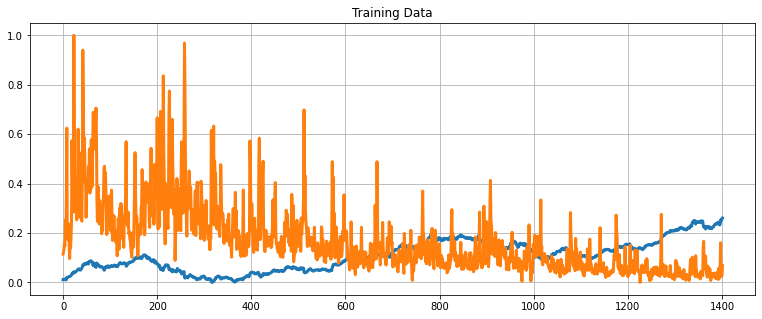

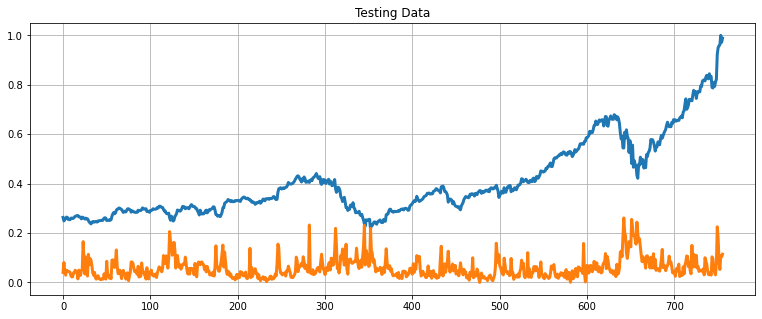

In [30]:
# Define a data plotting function
def show_plot(data, title):
  plt.figure(figsize = (13, 5))
  plt.plot(data, linewidth = 3)
  plt.title(title)
  plt.grid()

show_plot(X_train, 'Training Data')
show_plot(X_test, 'Testing Data')


## BUILD AND TRAIN A RIDGE LINEAR REGRESSION MODEL

In [43]:
from sklearn.linear_model import Ridge
# Note that Ridge regression performs linear least squares with L2 regularization.
# Create and train the Ridge Linear Regression  Model
regression_model = Ridge()
regression_model.fit(X_train, y_train)

Ridge()

In [44]:
# Test the model and calculate its accuracy 
lr_accuracy = regression_model.score(X_test, y_test)
print("Linear Regression Score: ", lr_accuracy)

Linear Regression Score:  0.7950028030821767


In [33]:
# Make Prediction
predicted_prices = regression_model.predict(X)
predicted_prices

array([[0.03466412],
       [0.03374627],
       [0.03451936],
       ...,
       [0.81048342],
       [0.78876033],
       [0.80091324]])

In [34]:
# Append the predicted values into a list
Predicted = []
for i in predicted_prices:
  Predicted.append(i[0])

In [35]:
# Append the close values to the list
close = []
for i in price_volume_target_scaled_df:
  close.append(i[0])


In [36]:
# Create a dataframe based on the dates in the individual stock data
df_predicted = price_volume_target_df[['Date']]
df_predicted

,Date
0,2012-01-12
1,2012-01-13
2,2012-01-17
3,2012-01-18
4,2012-01-19
...,...
2153,2020-08-04
2154,2020-08-05
2155,2020-08-06
2156,2020-08-07


In [37]:
# Add the close values to the dataframe
df_predicted['Close'] = close
df_predicted

,Date,Close
0,2012-01-12,0.011026
1,2012-01-13,0.010462
2,2012-01-17,0.012209
3,2012-01-18,0.013785
4,2012-01-19,0.013299
...,...,...
2153,2020-08-04,0.957606
2154,2020-08-05,0.961583
2155,2020-08-06,1.000000
2156,2020-08-07,0.972088


In [38]:
# Add the predicted values to the dataframe
df_predicted['Prediction'] = Predicted
df_predicted

,Date,Close,Prediction
0,2012-01-12,0.011026,0.034664
1,2012-01-13,0.010462,0.033746
2,2012-01-17,0.012209,0.034519
3,2012-01-18,0.013785,0.034556
4,2012-01-19,0.013299,0.034707
...,...,...,...
2153,2020-08-04,0.957606,0.778280
2154,2020-08-05,0.961583,0.783205
2155,2020-08-06,1.000000,0.810483
2156,2020-08-07,0.972088,0.788760


In [39]:
# Plot the results
interactive_plot(df_predicted, "Original Vs. Prediction")

## UNDERSTAND THE THEORY AND INTUITION BEHIND NEURAL NETWORKS

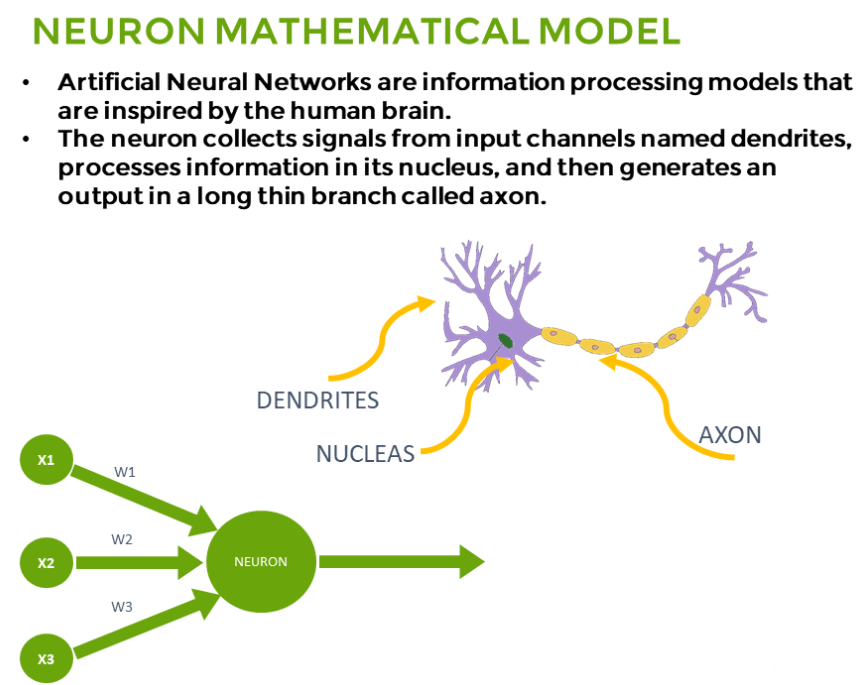

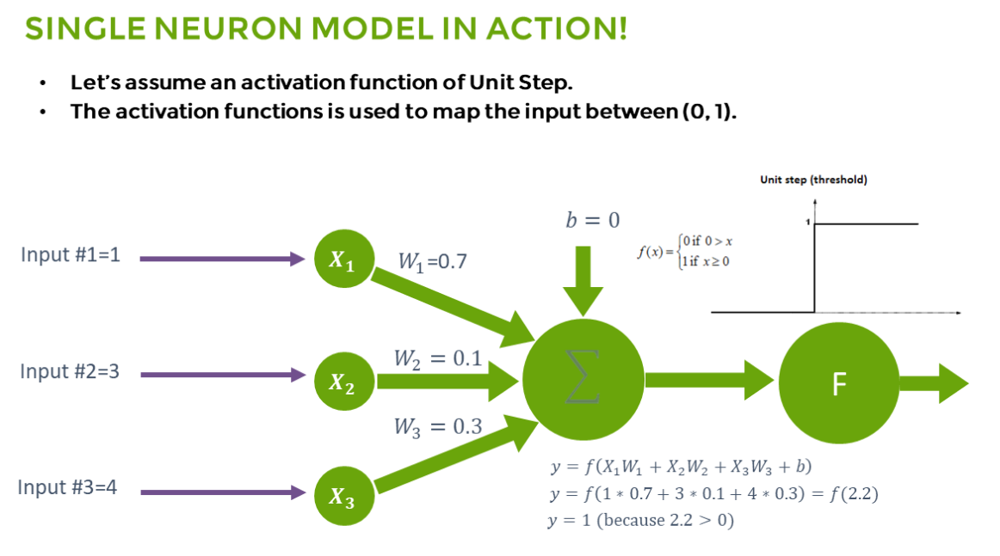

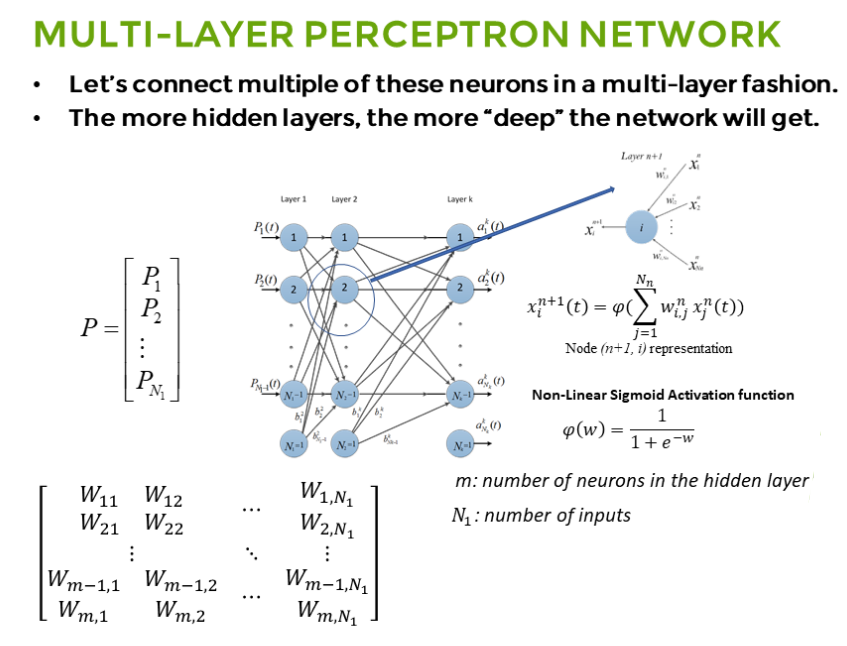

## UNDERSTAND HOW DO ARTFICIAL NEURAL NETWORKS TRAIN

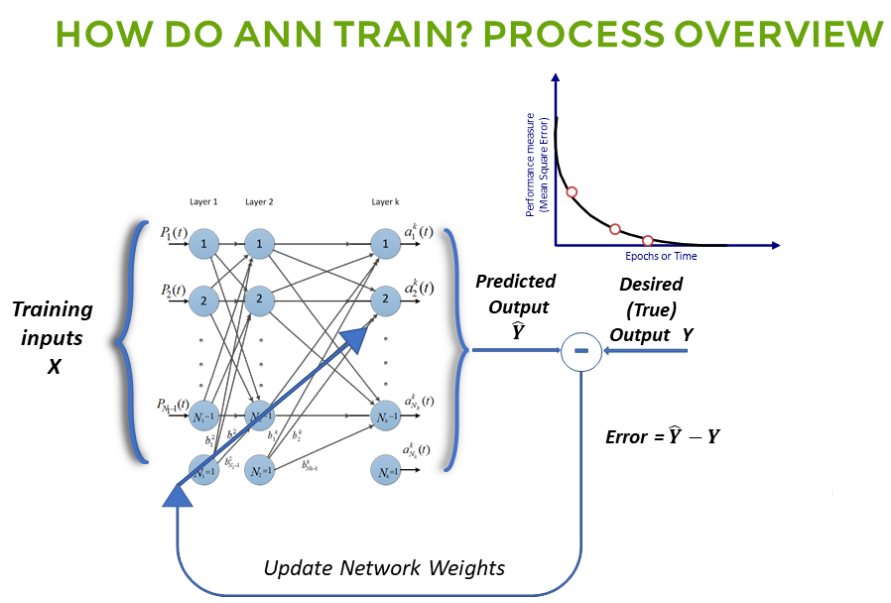

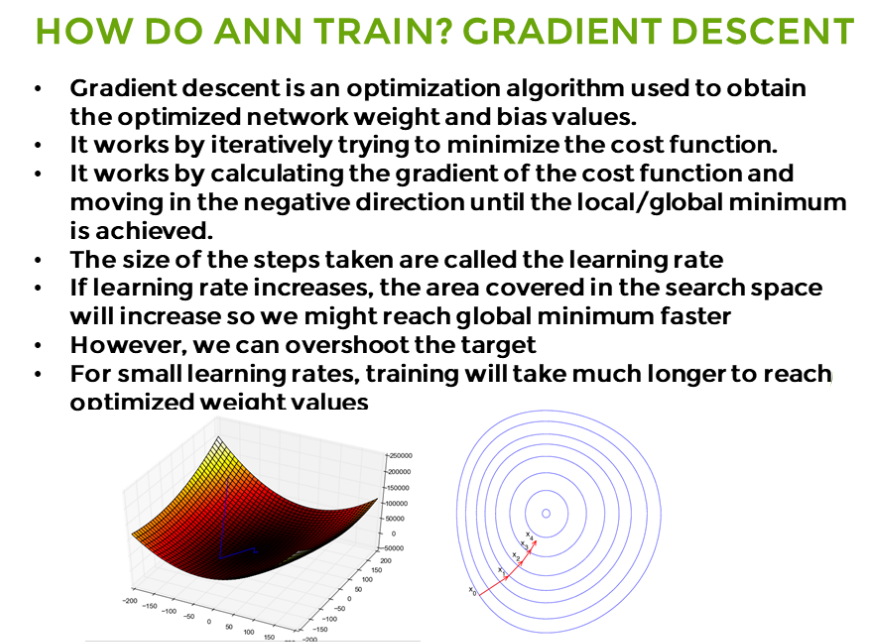

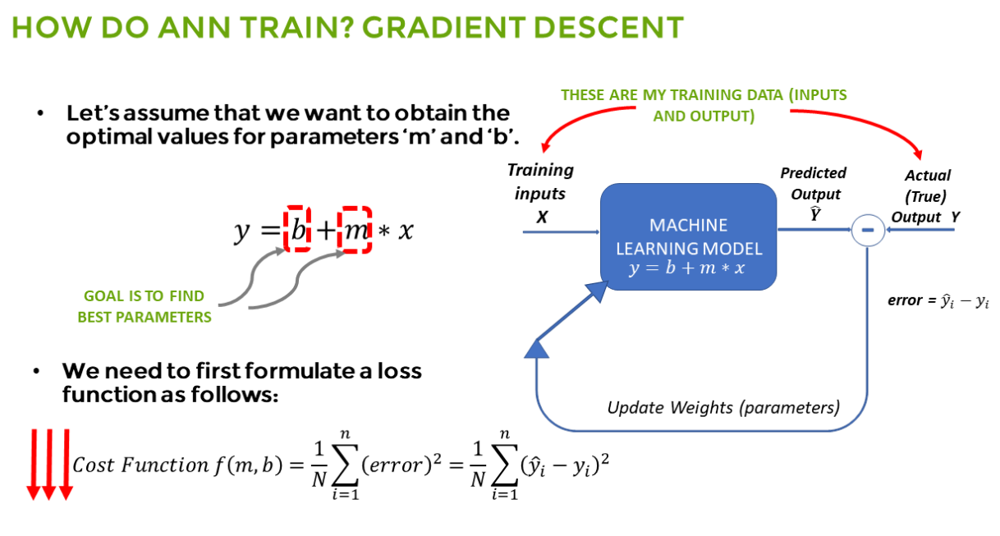

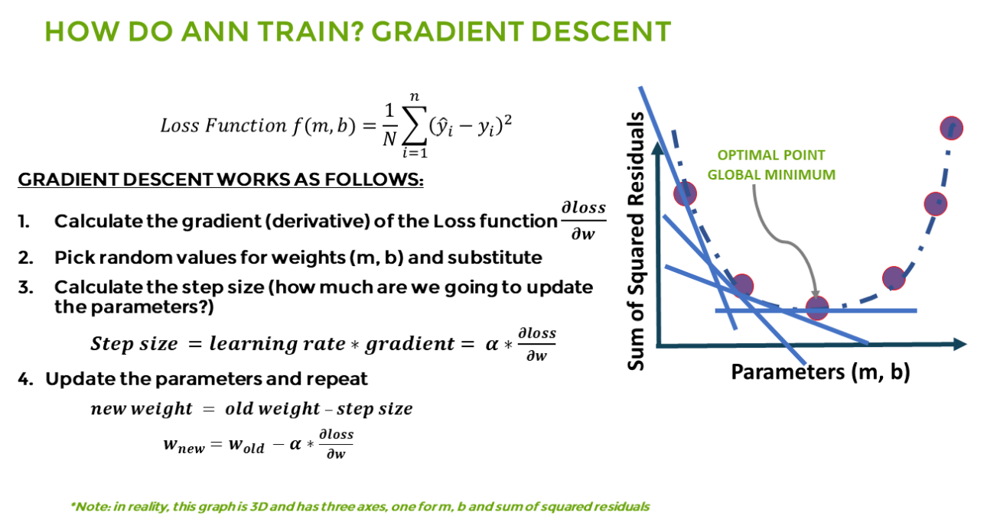

## UNDERSTAND THE THEORY AND INTUITION BEHIND RECURRENT NEURAL NETWORKS

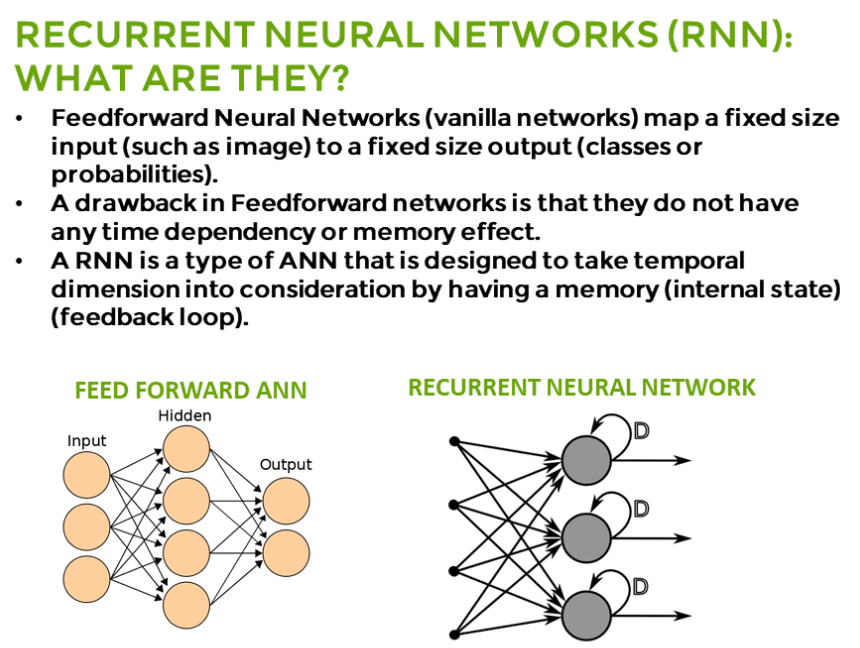

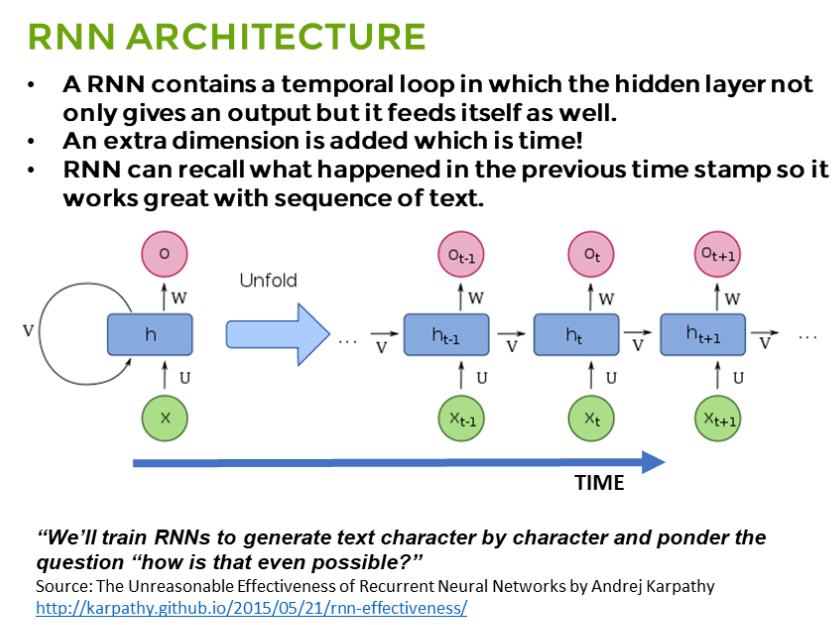

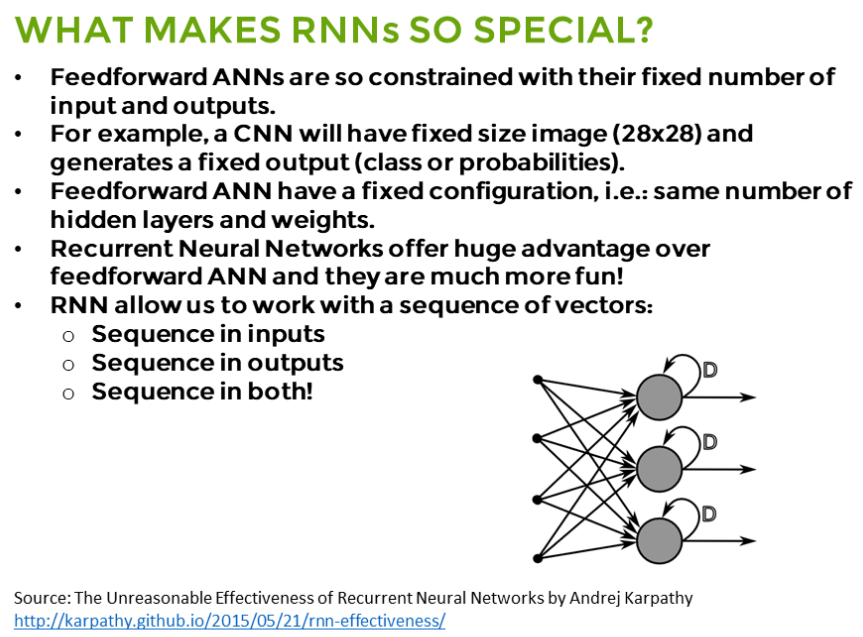

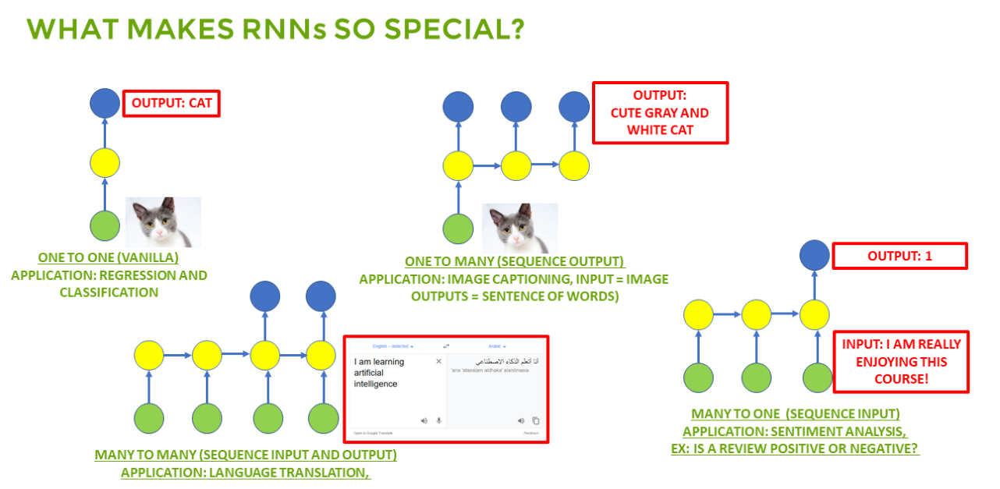

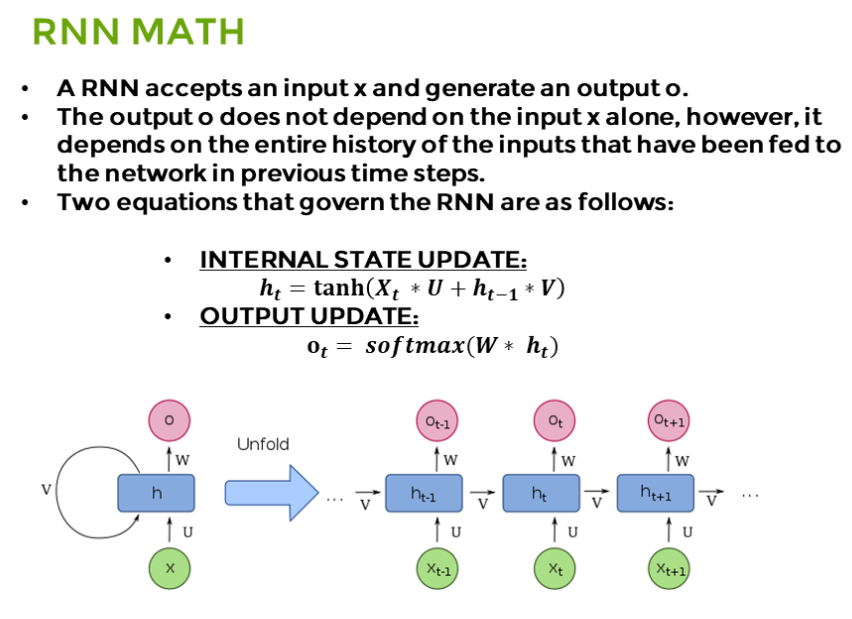

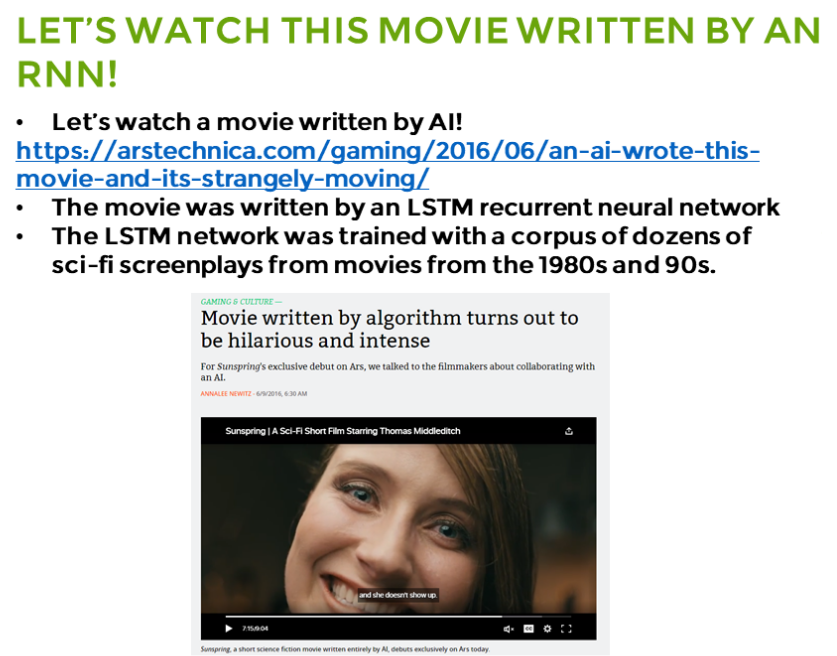

## UNDERSTAND THE THEORY AND INTUITION BEHIND LONG SHORT TERM MEMORY NETWORKS

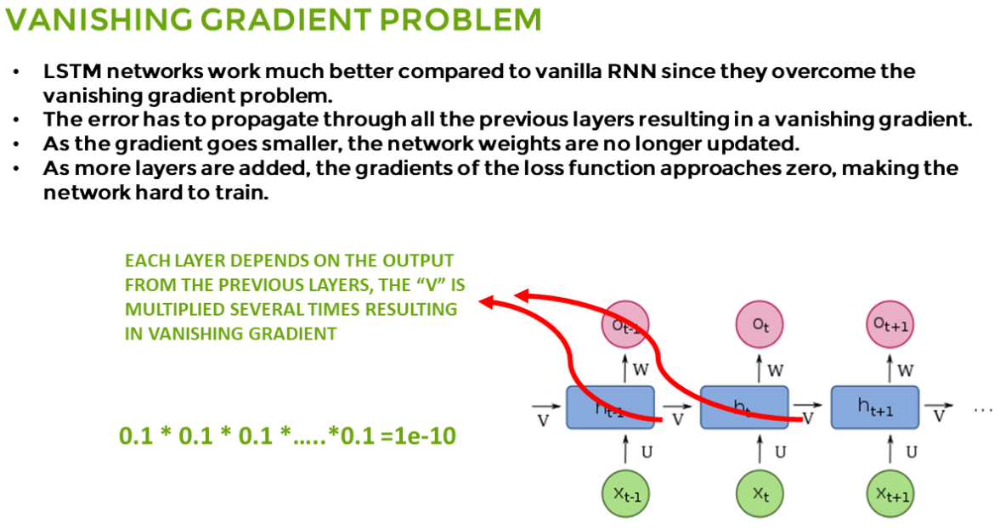

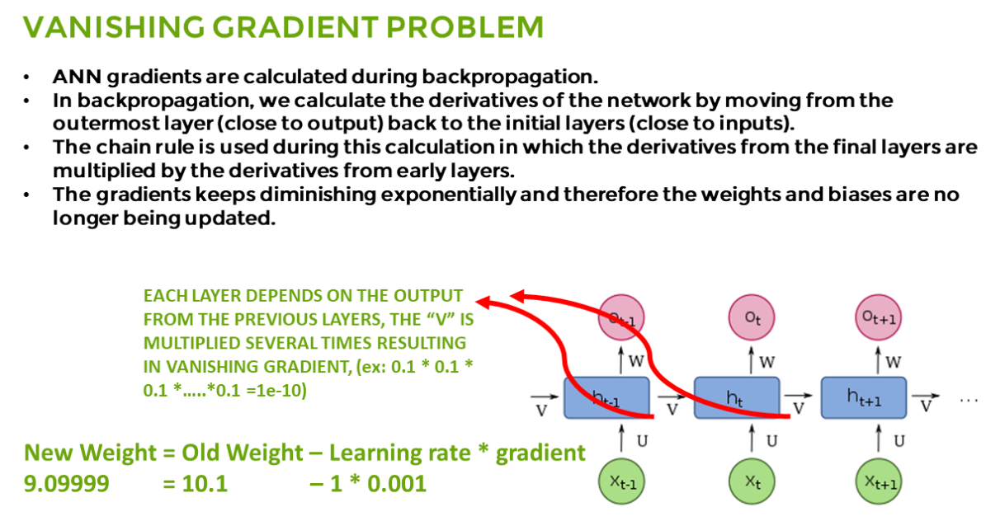

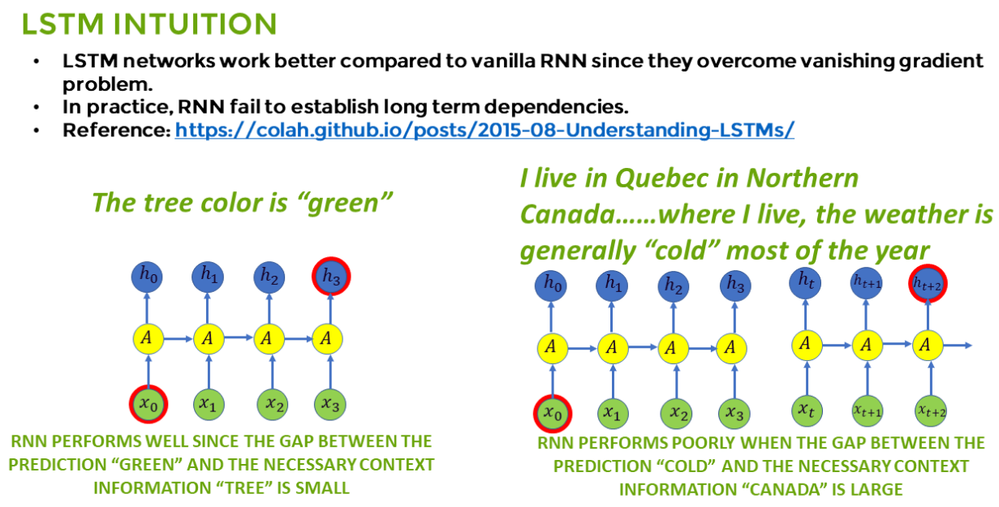

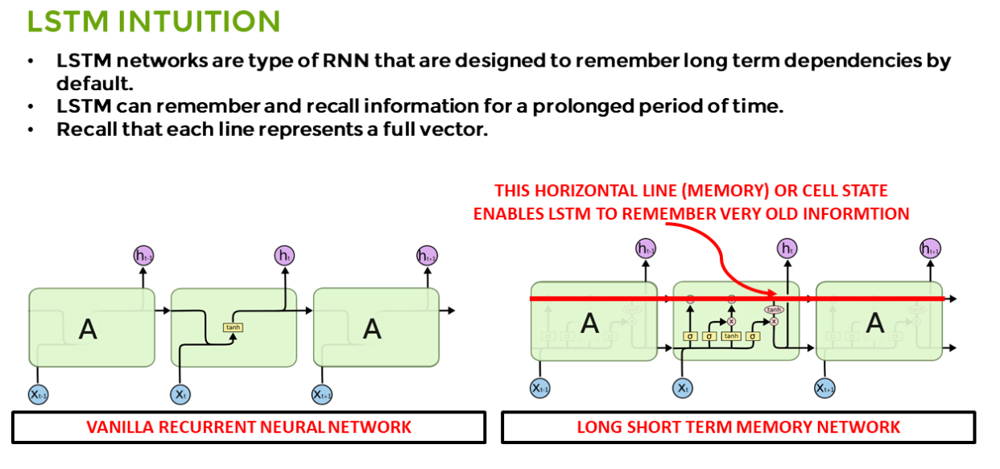

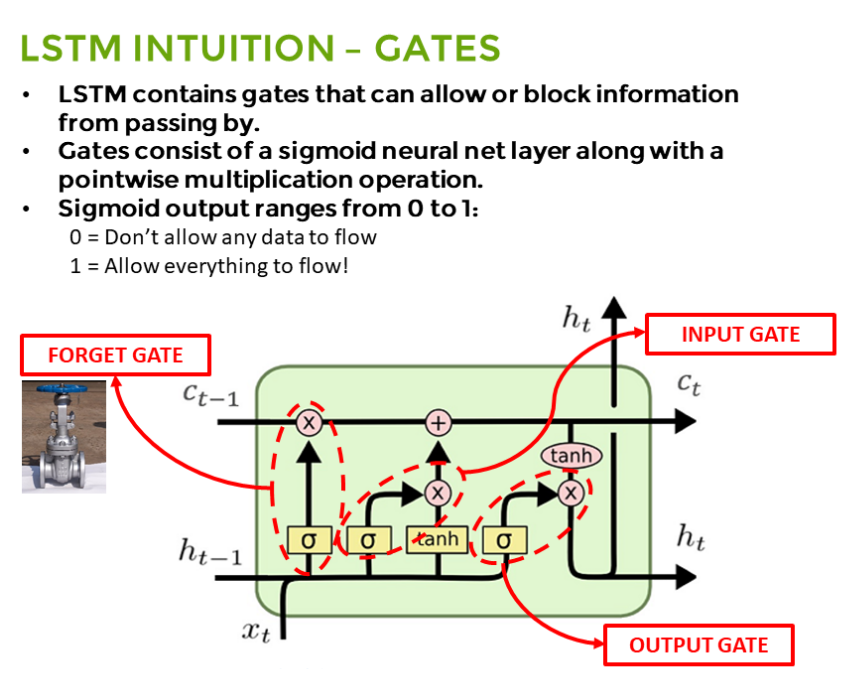

## TRAIN AN LSTM TIME SERIES MODEL

In [45]:
# Let's test the functions and get individual stock prices and volumes for AAPL
price_volume_df = individual_stock(stock_price_df, stock_vol_df, 'sp500')
price_volume_df

,Date,Close,Volume
0,2012-01-12,1295.500000,4019890000
1,2012-01-13,1289.089966,3692370000
2,2012-01-17,1293.670044,4010490000
3,2012-01-18,1308.040039,4096160000
4,2012-01-19,1314.500000,4465890000
...,...,...,...
2154,2020-08-05,3327.770020,4732220000
2155,2020-08-06,3349.159912,4267490000
2156,2020-08-07,3351.280029,4104860000
2157,2020-08-10,3360.469971,4318570000


In [46]:
# Get the close and volume data as training data (Input)
training_data = price_volume_df.iloc[:, 1:3].values
training_data

array([[1.29550000e+03, 4.01989000e+09],
       [1.28908997e+03, 3.69237000e+09],
       [1.29367004e+03, 4.01049000e+09],
       ...,
       [3.35128003e+03, 4.10486000e+09],
       [3.36046997e+03, 4.31857000e+09],
       [3.33368994e+03, 5.08765000e+09]])

In [47]:
# Normalize the data
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_data)

In [49]:
# Create the training and testing data, training data contains present day and previous day values
X = []
y = []
for i in range(1, len(price_volume_df)):
    X.append(training_set_scaled [i-1:i, 0])
    y.append(training_set_scaled [i, 0])

In [50]:
# Convert the data into array format
X = np.asarray(X)
y = np.asarray(y)

In [51]:
# Split the data
split = int(0.7 * len(X))
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

In [53]:
# Reshape the 1D arrays to 3D arrays to feed in the model
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_train.shape, X_test.shape

((1510, 1, 1), (648, 1, 1))

In [54]:
# Create the model
inputs = keras.layers.Input(shape=(X_train.shape[1], X_train.shape[2]))
x = keras.layers.LSTM(150, return_sequences= True)(inputs)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150, return_sequences=True)(x)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150)(x)
outputs = keras.layers.Dense(1, activation='linear')(x) # SIGMOID IS NOT RECOMMENDED

model = keras.Model(inputs=inputs, outputs=outputs)
model.compile(optimizer='adam', loss="mse")
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 1, 1)]            0         
                                                                 
 lstm (LSTM)                 (None, 1, 150)            91200     
                                                                 
 dropout (Dropout)           (None, 1, 150)            0         
                                                                 
 lstm_1 (LSTM)               (None, 1, 150)            180600    
                                                                 
 dropout_1 (Dropout)         (None, 1, 150)            0         
                                                                 
 lstm_2 (LSTM)               (None, 150)               180600    
                                                                 
 dense (Dense)               (None, 1)                 151   

In [55]:
# Train the model
history = model.fit(
    X_train, y_train,
    epochs = 20,
    batch_size = 32,
    validation_split = 0.2
)

Epoch 1/20
38/38 [==============================] - 7s 43ms/step - loss: 0.0314 - val_loss: 0.0543
Epoch 2/20
38/38 [==============================] - 0s 10ms/step - loss: 0.0058 - val_loss: 1.0907e-04
Epoch 3/20
38/38 [==============================] - 0s 10ms/step - loss: 5.3274e-04 - val_loss: 5.6084e-05
Epoch 4/20
38/38 [==============================] - 0s 10ms/step - loss: 4.6154e-04 - val_loss: 2.2078e-04
Epoch 5/20
38/38 [==============================] - 0s 10ms/step - loss: 3.5309e-04 - val_loss: 3.5481e-04
Epoch 6/20
38/38 [==============================] - 0s 11ms/step - loss: 3.5011e-04 - val_loss: 4.5837e-05
Epoch 7/20
38/38 [==============================] - 0s 11ms/step - loss: 3.0532e-04 - val_loss: 1.1924e-04
Epoch 8/20
38/38 [==============================] - 0s 11ms/step - loss: 3.1649e-04 - val_loss: 6.9844e-05
Epoch 9/20
38/38 [==============================] - 0s 12ms/step - loss: 3.0386e-04 - val_loss: 4.3521e-05
Epoch 10/20
38/38 [==============================

In [56]:
# Make prediction
predicted = model.predict(X)

In [62]:
# Append the predicted values to the list
test_predicted = []

for i in predicted:
  test_predicted.append(i[0])

In [63]:
test_predicted

[0.015260377,
 0.012223112,
 0.014393315,
 0.021201394,
 0.024261476,
 0.024678295,
 0.024971977,
 0.024332525,
 0.029736668,
 0.026122974,
 0.025128255,
 0.023555685,
 0.023271479,
 0.028803645,
 0.029490398,
 0.03865766,
 0.038387775,
 0.039675552,
 0.04105313,
 0.04199517,
 0.037587665,
 0.04190999,
 0.04130878,
 0.037866987,
 0.04487794,
 0.04638779,
 0.046851616,
 0.04469808,
 0.047443226,
 0.0485223,
 0.04939782,
 0.05156996,
 0.04849394,
 0.05247373,
 0.050363235,
 0.047854975,
 0.03792852,
 0.042317092,
 0.048602775,
 0.050950028,
 0.05105412,
 0.06281545,
 0.062025584,
 0.06596061,
 0.066703126,
 0.06934177,
 0.06734153,
 0.06609778,
 0.061316073,
 0.063364126,
 0.072538026,
 0.07065154,
 0.06735099,
 0.06628222,
 0.0687365,
 0.07373415,
 0.07105816,
 0.06423911,
 0.063822895,
 0.056310996,
 0.04513824,
 0.04992784,
 0.058851495,
 0.05066137,
 0.05033482,
 0.06037002,
 0.057701938,
 0.053812858,
 0.05457464,
 0.04909019,
 0.051470548,
 0.060327403,
 0.064721525,
 0.06632004,
 

In [64]:
df_predicted = price_volume_df[1:][['Date']]
df_predicted

,Date
1,2012-01-13
2,2012-01-17
3,2012-01-18
4,2012-01-19
5,2012-01-20
...,...
2154,2020-08-05
2155,2020-08-06
2156,2020-08-07
2157,2020-08-10


In [65]:
df_predicted['predictions'] = test_predicted

In [66]:
df_predicted

,Date,predictions
1,2012-01-13,0.015260
2,2012-01-17,0.012223
3,2012-01-18,0.014393
4,2012-01-19,0.021201
5,2012-01-20,0.024261
...,...,...
2154,2020-08-05,0.917319
2155,2020-08-06,0.925941
2156,2020-08-07,0.934589
2157,2020-08-10,0.935444


In [67]:
# Plot the data
close = []
for i in training_set_scaled:
  close.append(i[0])


In [68]:
df_predicted['Close'] = close[1:]

In [69]:
df_predicted

,Date,predictions,Close
1,2012-01-13,0.015260,0.005242
2,2012-01-17,0.012223,0.007414
3,2012-01-18,0.014393,0.014231
4,2012-01-19,0.021201,0.017295
5,2012-01-20,0.024261,0.017713
...,...,...,...
2154,2020-08-05,0.917319,0.972307
2155,2020-08-06,0.925941,0.982453
2156,2020-08-07,0.934589,0.983459
2157,2020-08-10,0.935444,0.987819


In [70]:
# Plot the data
interactive_plot(df_predicted, "Original Vs Prediction")

# Perform Bank Customers Segmentation

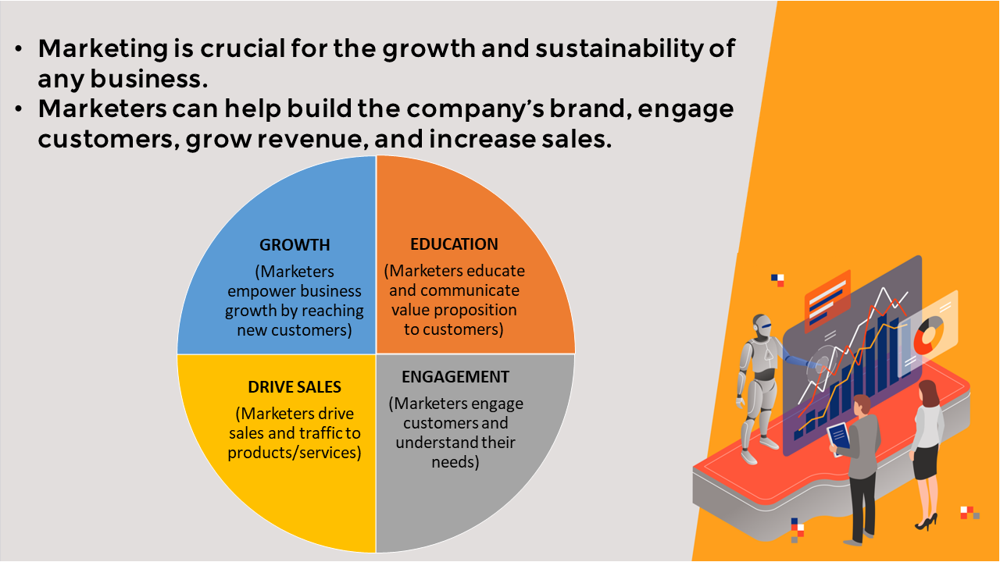

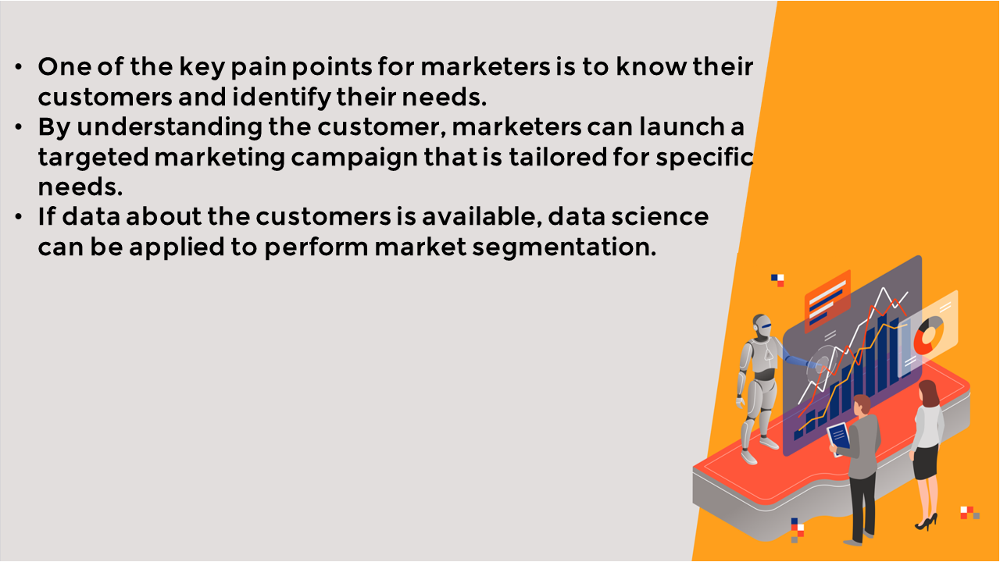

## IMPORT LIBRARIES AND DATASETS

In [71]:
import seaborn as sns
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [72]:
# You have to include the full link to the csv file containing your dataset
creditcard_df = pd.read_csv('/content/drive/MyDrive/my files/Financial Analysis/Marketing_data.csv')

# CUSTID: Identification of Credit Card holder 
# BALANCE: Balance amount left in customer's account to make purchases
# BALANCE_FREQUENCY: How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
# PURCHASES: Amount of purchases made from account
# ONEOFFPURCHASES: Maximum purchase amount done in one-go
# INSTALLMENTS_PURCHASES: Amount of purchase done in installment
# CASH_ADVANCE: Cash in advance given by the user
# PURCHASES_FREQUENCY: How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
# ONEOFF_PURCHASES_FREQUENCY: How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
# PURCHASES_INSTALLMENTS_FREQUENCY: How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
# CASH_ADVANCE_FREQUENCY: How frequently the cash in advance being paid
# CASH_ADVANCE_TRX: Number of Transactions made with "Cash in Advance"
# PURCHASES_TRX: Number of purchase transactions made
# CREDIT_LIMIT: Limit of Credit Card for user
# PAYMENTS: Amount of Payment done by user
# MINIMUM_PAYMENTS: Minimum amount of payments made by user  
# PRC_FULL_PAYMENT: Percent of full payment paid by user
# TENURE: Tenure of credit card service for user

In [73]:
creditcard_df

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [74]:
creditcard_df.info()
# 18 features with 8950 points  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [75]:
creditcard_df.describe()
# Mean balance is $1564 
# Balance frequency is frequently updated on average ~0.9
# Purchases average is $1000
# one off purchase average is ~$600
# Average purchases frequency is around 0.5
# average ONEOFF_PURCHASES_FREQUENCY, PURCHASES_INSTALLMENTS_FREQUENCY, and CASH_ADVANCE_FREQUENCY are generally low
# Average credit limit ~ 4500
# Percent of full payment is 15%
# Average tenure is 11 years

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


## VISUALIZE AND EXPLORE DATASET

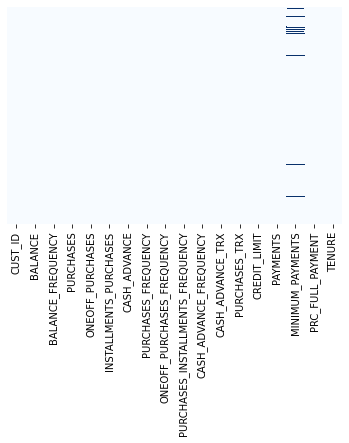

In [83]:
# Let's see if we have any missing data.
sns.heatmap(creditcard_df.isnull(), yticklabels = False, cbar = False, cmap="Blues")

In [84]:
creditcard_df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [85]:
# Fill up the missing elements with mean of the 'MINIMUM_PAYMENT' 
creditcard_df.loc[(creditcard_df['MINIMUM_PAYMENTS'].isnull() == True), 'MINIMUM_PAYMENTS'] = creditcard_df['MINIMUM_PAYMENTS'].mean()


In [86]:
# Fill up the missing elements with mean of the 'CREDIT_LIMIT' 
creditcard_df.loc[(creditcard_df['CREDIT_LIMIT'].isnull() == True), 'CREDIT_LIMIT'] = creditcard_df['CREDIT_LIMIT'].mean()

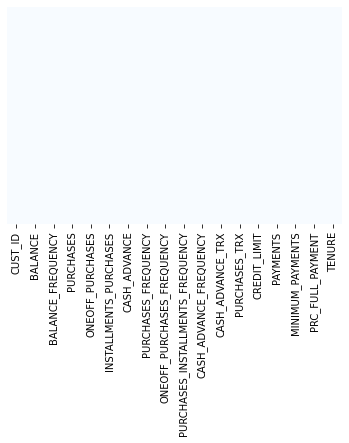

In [87]:
sns.heatmap(creditcard_df.isnull(), yticklabels = False, cbar = False, cmap="Blues")

In [88]:
# Let's see if we have duplicated entries in the data
creditcard_df.duplicated().sum()

0

In [89]:
# Let's drop Customer ID since it has no meaning here 
creditcard_df.drop("CUST_ID", axis = 1, inplace= True)

In [90]:
creditcard_df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


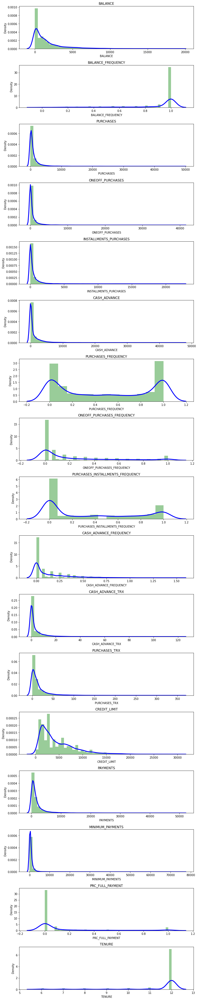

In [91]:
# distplot combines the matplotlib.hist function with seaborn kdeplot()
# KDE Plot represents the Kernel Density Estimate
# KDE is used for visualizing the Probability Density of a continuous variable. 
# KDE demonstrates the probability density at different values in a continuous variable. 

# Mean of balance is $1500
# 'Balance_Frequency' for most customers is updated frequently ~1
# For 'PURCHASES_FREQUENCY', there are two distinct group of customers
# For 'ONEOFF_PURCHASES_FREQUENCY' and 'PURCHASES_INSTALLMENT_FREQUENCY' most users don't do one off puchases or installment purchases frequently 
# Very small number of customers pay their balance in full 'PRC_FULL_PAYMENT'~0
# Credit limit average is around $4500
# Most customers are ~11 years tenure

plt.figure(figsize=(10,50))
for i in range(len(creditcard_df.columns)):
  plt.subplot(17, 1, i+1)
  sns.distplot(creditcard_df[creditcard_df.columns[i]], kde_kws={"color": "b", "lw": 3, "label": "KDE"}, hist_kws={"color": "g"})
  plt.title(creditcard_df.columns[i])

plt.tight_layout()

In [92]:
correlations = creditcard_df.corr()


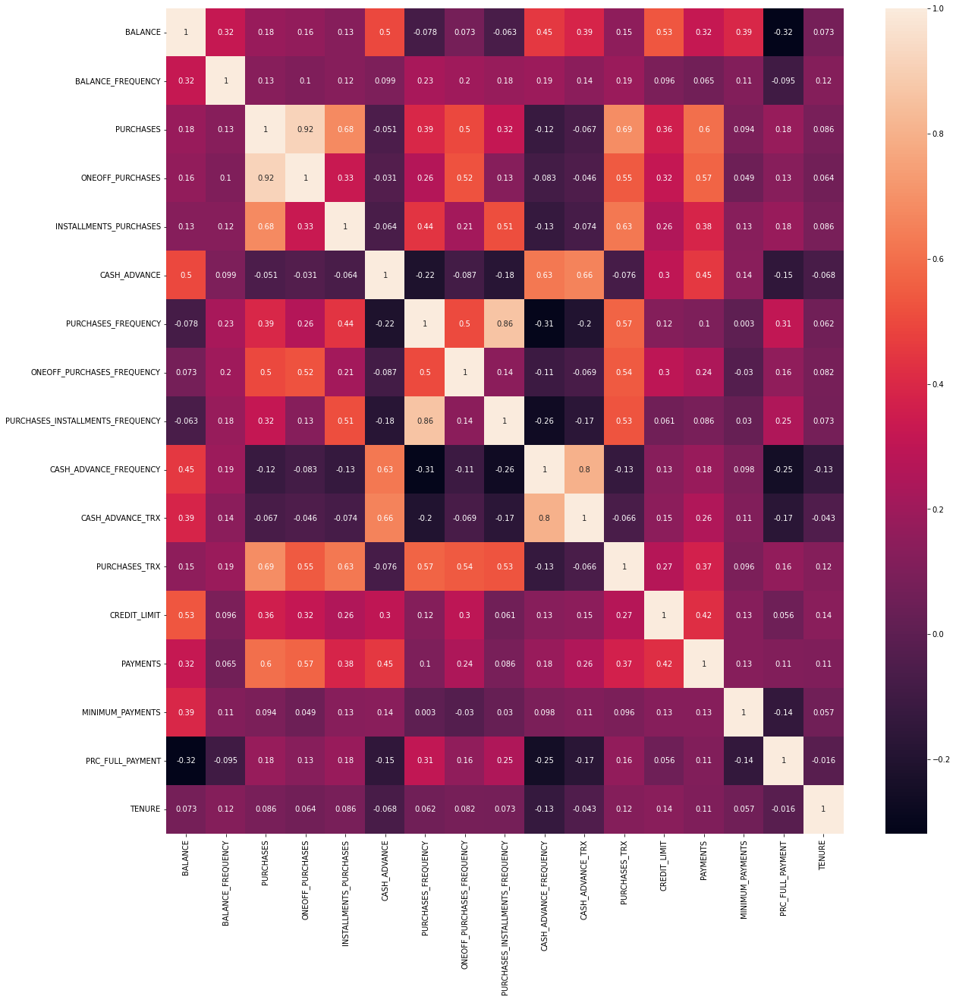

In [93]:
f, ax = plt.subplots(figsize = (20, 20))
sns.heatmap(correlations, annot = True)

# 'PURCHASES' have high correlation between one-off purchases, 'installment purchases, purchase transactions, credit limit and payments. 
# Strong Positive Correlation between 'PURCHASES_FREQUENCY' and 'PURCHASES_INSTALLMENT_FREQUENCY'


## FIND THE OPTIMAL NUMBER OF CLUSTERS USING ELBOW METHOD

- The elbow method is a heuristic method of interpretation and validation of consistency within cluster analysis designed to help find the appropriate number of clusters in a dataset. 
- If the line chart looks like an arm, then the "elbow" on the arm is the value of k that is the best.
- Source: 
  - https://en.wikipedia.org/wiki/Elbow_method_(clustering)
  - https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/

In [94]:
# Let's scale the data first
scaler = StandardScaler()
creditcard_df_scaled = scaler.fit_transform(creditcard_df)

In [95]:
creditcard_df_scaled.shape

(8950, 17)

In [96]:
creditcard_df_scaled

array([[-0.73198937, -0.24943448, -0.42489974, ..., -0.31096755,
        -0.52555097,  0.36067954],
       [ 0.78696085,  0.13432467, -0.46955188, ...,  0.08931021,
         0.2342269 ,  0.36067954],
       [ 0.44713513,  0.51808382, -0.10766823, ..., -0.10166318,
        -0.52555097,  0.36067954],
       ...,
       [-0.7403981 , -0.18547673, -0.40196519, ..., -0.33546549,
         0.32919999, -4.12276757],
       [-0.74517423, -0.18547673, -0.46955188, ..., -0.34690648,
         0.32919999, -4.12276757],
       [-0.57257511, -0.88903307,  0.04214581, ..., -0.33294642,
        -0.52555097, -4.12276757]])

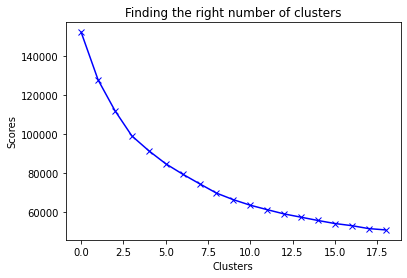

In [97]:
scores_1 = []

range_values = range(1, 20)

for i in range_values:
  kmeans = KMeans(n_clusters = i)
  kmeans.fit(creditcard_df_scaled)
  scores_1.append(kmeans.inertia_) 

plt.plot(scores_1, 'bx-')
plt.title('Finding the right number of clusters')
plt.xlabel('Clusters')
plt.ylabel('Scores') 
plt.show()

# From this we can observe that, 4th cluster seems to be forming the elbow of the curve. 
# However, the values does not reduce linearly until 8th cluster. 
# Let's choose the number of clusters to be 7.

## APPLY K-MEANS METHOD

In [98]:
kmeans = KMeans(8)
kmeans.fit(creditcard_df_scaled)
labels = kmeans.labels_

In [99]:
kmeans.cluster_centers_.shape

(8, 17)

In [100]:
cluster_centers = pd.DataFrame(data = kmeans.cluster_centers_, columns = [creditcard_df.columns])
cluster_centers           

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1.586392,0.372810,-0.223189,-0.157471,-0.238496,1.965580,-0.476947,-0.206092,-0.423325,1.922000,1.869440,-0.273198,0.973076,0.758869,0.358310,-0.389570,-0.086870
1,-0.159843,0.382817,0.414326,0.550365,-0.031558,-0.336734,0.912641,1.815132,0.080838,-0.402131,-0.323196,0.493371,0.343484,0.060319,-0.161745,0.362757,0.177101
2,0.854286,0.468202,2.253810,1.777191,2.064153,-0.191515,1.161671,1.623811,1.203861,-0.302453,-0.210245,2.703158,1.237800,1.275843,0.276439,0.315309,0.333569
3,-0.009025,0.369035,-0.365611,-0.249350,-0.406297,-0.071373,-0.882708,-0.416834,-0.771175,0.153335,-0.015797,-0.494117,-0.343244,-0.267172,-0.054079,-0.455565,-0.015530
4,-0.395989,0.309275,-0.060535,-0.255402,0.326035,-0.361251,0.981182,-0.411105,1.177583,-0.462694,-0.358179,0.140622,-0.313414,-0.242213,-0.109887,0.361496,-0.022415
5,1.923051,0.337717,11.212042,10.600367,7.033118,0.419625,1.046983,1.915501,0.981334,-0.258912,0.061229,5.362438,3.044064,8.098975,1.120318,1.110132,0.310863
6,-0.698427,-2.137607,-0.318551,-0.237369,-0.317018,-0.307231,-0.566475,-0.436873,-0.459653,-0.488017,-0.362312,-0.428317,-0.215461,-0.222589,-0.255451,0.250843,-0.152326
7,1.290312,0.454124,-0.039755,-0.268864,0.399233,-0.000938,0.022469,-0.528409,0.262206,-0.252602,-0.060885,0.219536,-0.004964,-0.129901,11.641856,-0.525551,0.298409


In [101]:
# In order to understand what these numbers mean, let's perform inverse transformation
cluster_centers = scaler.inverse_transform(cluster_centers)
cluster_centers = pd.DataFrame(data = cluster_centers, columns = [creditcard_df.columns])
cluster_centers

# First Customers cluster (Transactors): Those are customers who pay least amount of intrerest charges and careful with their money, Cluster with lowest balance ($104) and cash advance ($303), Percentage of full payment = 23%
# Second customers cluster (revolvers) who use credit card as a loan (most lucrative sector): highest balance ($5000) and cash advance (~$5000), low purchase frequency, high cash advance frequency (0.5), high cash advance transactions (16) and low percentage of full payment (3%)
# Third customer cluster (VIP/Prime): high credit limit $16K and highest percentage of full payment, target for increase credit limit and increase spending habits
# Fourth customer cluster (low tenure): these are customers with low tenure (7 years), low balance 


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,4866.416704,0.965586,526.357649,331.067340,195.398468,5100.785135,0.298929,0.140976,0.196197,0.519756,16.006383,7.919149,8034.898453,3929.994514,1699.233327,0.039772,11.401064
1,1231.775177,0.967957,1888.418780,1505.930744,382.530424,272.723171,0.856638,0.743947,0.396564,0.054674,1.043253,26.973183,5744.186065,1907.762633,487.265697,0.259815,11.754325
2,3342.598461,0.988183,5818.505170,3542.210091,2277.655624,577.255287,0.956585,0.686872,0.842882,0.074620,1.814059,81.900227,8998.072562,5426.583944,1508.436112,0.245937,11.963719
3,1545.690676,0.964692,222.070561,178.566913,43.658146,829.199644,0.136077,0.078108,0.057953,0.165828,3.141026,2.427928,3245.587896,959.706488,738.177198,0.020470,11.496535
4,740.256582,0.950535,873.869885,168.522900,705.897137,221.310674,0.884146,0.079817,0.832439,0.042554,0.804518,18.205164,3354.120970,1031.959925,608.119210,0.259446,11.487321
5,5567.142164,0.957273,24957.905000,18186.875667,6771.029333,1858.844605,0.910556,0.773889,0.754444,0.083333,3.666667,148.000000,15570.000000,25178.882690,3475.059479,0.478409,11.933333
6,110.758883,0.370891,322.616091,198.453266,124.392546,334.592870,0.262997,0.072130,0.181760,0.037487,0.776316,4.063467,3710.513850,1088.769119,268.889924,0.227082,11.313467
7,4250.150569,0.984849,918.267222,146.178056,772.089167,976.903069,0.499369,0.044823,0.468645,0.084596,2.833333,20.166667,4476.388889,1357.092339,27995.061876,0.000000,11.916667


In [102]:
labels.shape # Labels associated to each data point

(8950,)

In [103]:
labels.max()

7

In [104]:
labels.min()

0

In [105]:
y_kmeans = kmeans.fit_predict(creditcard_df_scaled)
y_kmeans

array([5, 2, 3, ..., 7, 7, 7], dtype=int32)

In [106]:
# concatenate the clusters labels to our original dataframe
creditcard_df_cluster = pd.concat([creditcard_df, pd.DataFrame({'cluster':labels})], axis = 1)
creditcard_df_cluster.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,3
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,1
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,3
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,3


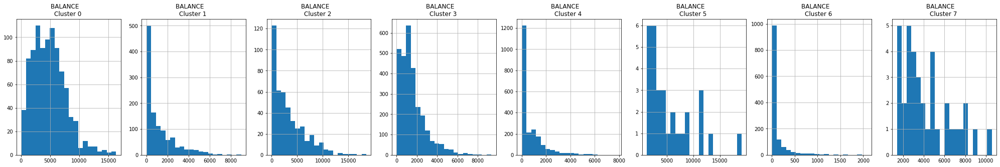

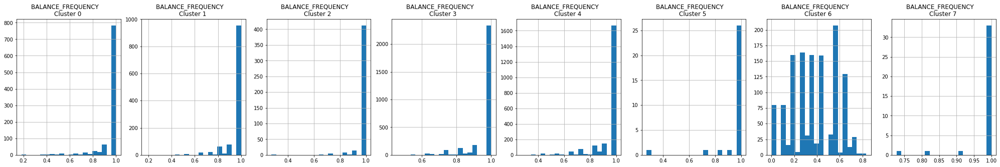

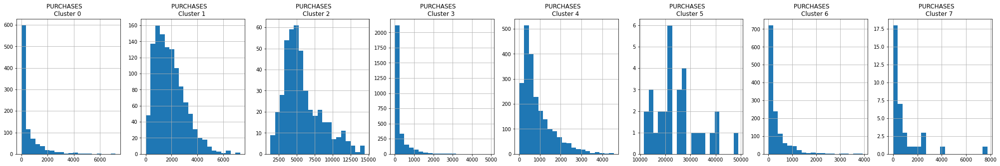

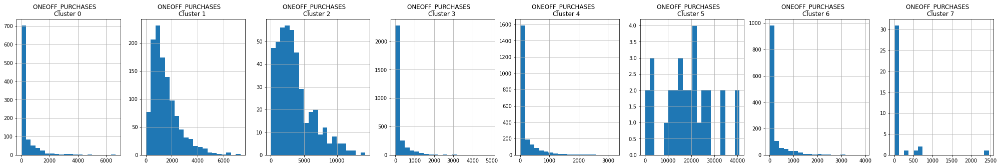

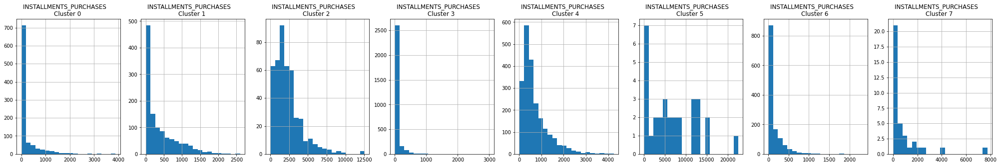

...

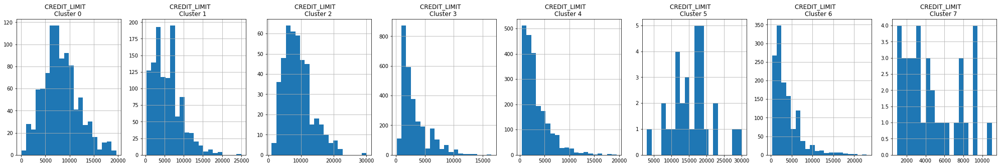

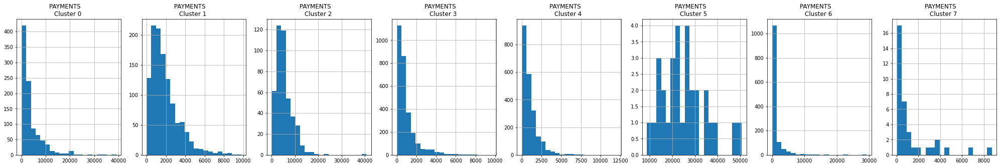

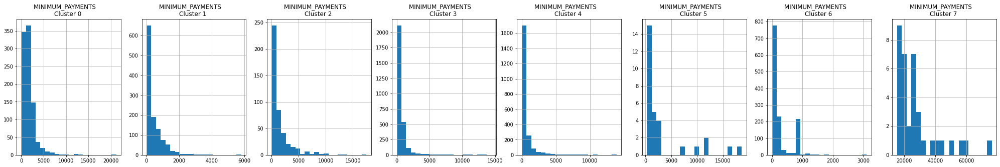

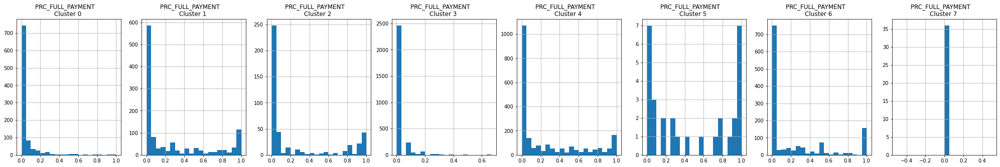

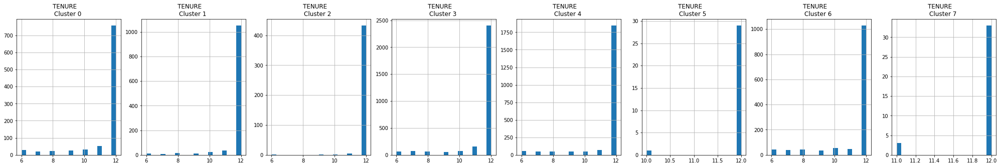

In [107]:
# Plot the histogram of various clusters
for i in creditcard_df.columns:
  plt.figure(figsize = (35, 5))
  for j in range(8):
    plt.subplot(1,8,j+1)
    cluster = creditcard_df_cluster[creditcard_df_cluster['cluster'] == j]
    cluster[i].hist(bins = 20)
    plt.title('{}    \nCluster {} '.format(i,j))
  
  plt.show()



## APPLY PRINCIPAL COMPONENT ANALYSIS AND VISUALIZE THE RESULTS

In [108]:
# Obtain the principal components 
pca = PCA(n_components=2)
principal_comp = pca.fit_transform(creditcard_df_scaled)
principal_comp

array([[-1.68222015, -1.07645232],
       [-1.13828065,  2.50642238],
       [ 0.96970845, -0.38359857],
       ...,
       [-0.92621071, -1.81076112],
       [-2.33656616, -0.65791713],
       [-0.55641946, -0.40047344]])

In [109]:
# Create a dataframe with the two components
pca_df = pd.DataFrame(data = principal_comp, columns =['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,-1.682220,-1.076452
1,-1.138281,2.506422
2,0.969708,-0.383599
3,-0.873629,0.043167
4,-1.599434,-0.688580


In [110]:
# Concatenate the clusters labels to the dataframe
pca_df = pd.concat([pca_df,pd.DataFrame({'cluster':labels})], axis = 1)
pca_df.head()

,pca1,pca2,cluster
0,-1.682220,-1.076452,3
1,-1.138281,2.506422,0
2,0.969708,-0.383599,1
3,-0.873629,0.043167,3
4,-1.599434,-0.688580,3


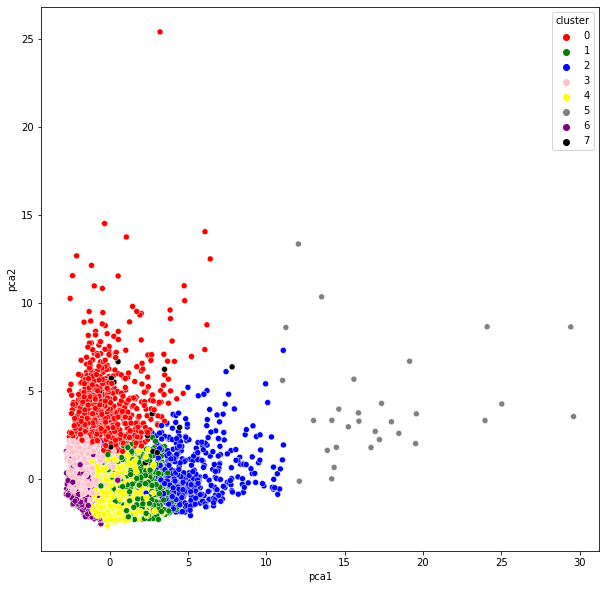

In [111]:
plt.figure(figsize=(10,10))
ax = sns.scatterplot(x="pca1", y="pca2", hue = "cluster", data = pca_df, palette =['red','green','blue','pink','yellow','gray','purple', 'black'])
plt.show()

## UNDERSTAND THE THEORY AND INTUITION BEHIND AUTOENCODERS

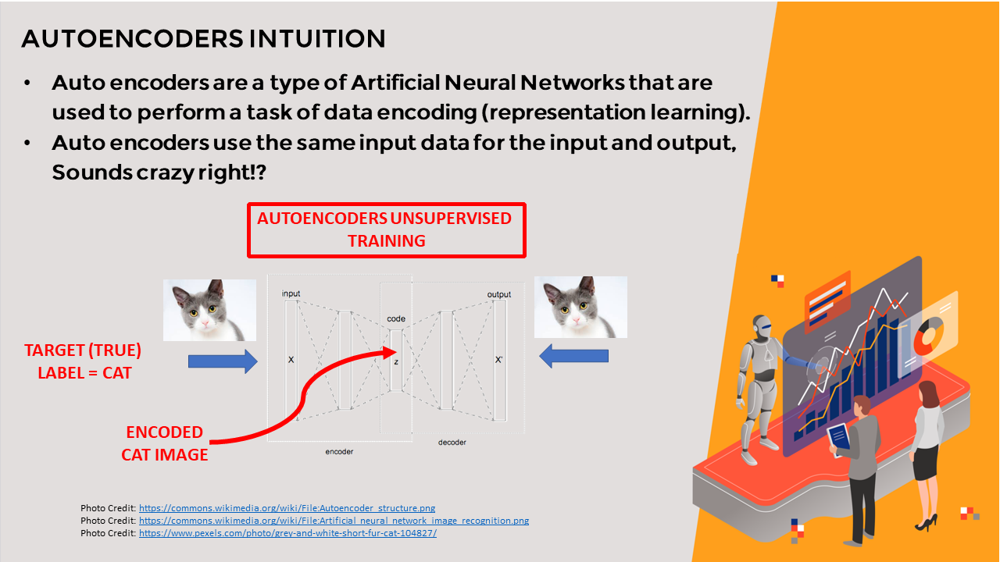

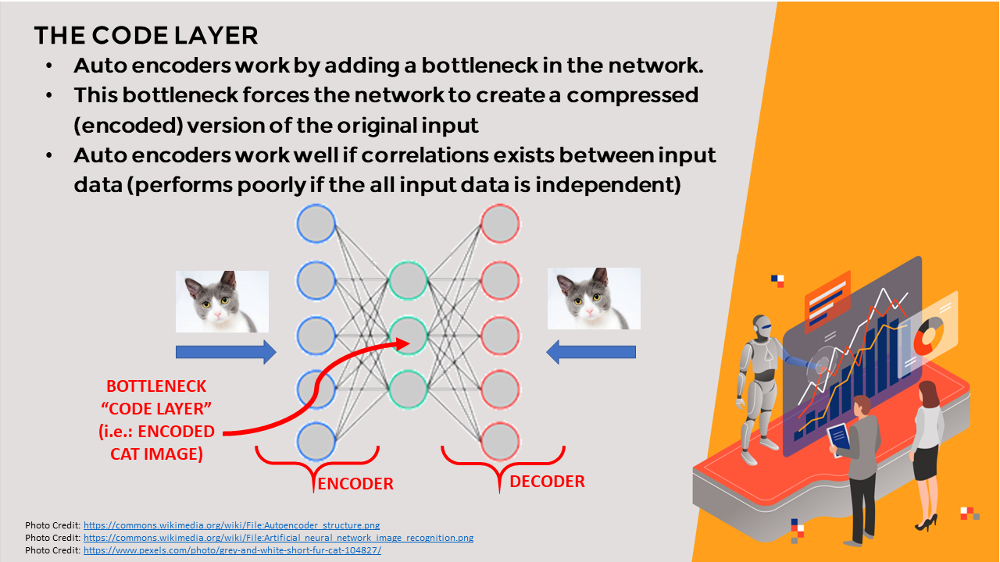

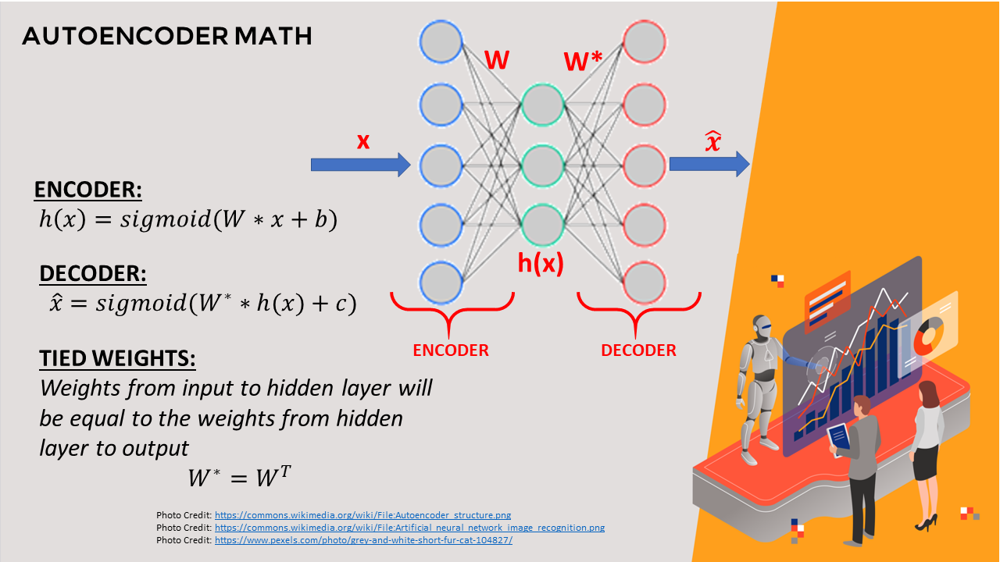

## APPLY AUTOENCODERS (PERFORM DIMENSIONALITY REDUCTION USING AUTOENCODERS)

In [113]:
from tensorflow.keras.layers import Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, Dropout
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.optimizers import SGD

encoding_dim = 7

input_df = Input(shape=(17,))


# Glorot normal initializer (Xavier normal initializer) draws samples from a truncated normal distribution 

x = Dense(encoding_dim, activation='relu')(input_df)
x = Dense(500, activation='relu', kernel_initializer = 'glorot_uniform')(x)
x = Dense(500, activation='relu', kernel_initializer = 'glorot_uniform')(x)
x = Dense(2000, activation='relu', kernel_initializer = 'glorot_uniform')(x)

encoded = Dense(10, activation='relu', kernel_initializer = 'glorot_uniform')(x)

x = Dense(2000, activation='relu', kernel_initializer = 'glorot_uniform')(encoded)
x = Dense(500, activation='relu', kernel_initializer = 'glorot_uniform')(x)

decoded = Dense(17, kernel_initializer = 'glorot_uniform')(x)

# autoencoder
autoencoder = Model(input_df, decoded)

#encoder - used for our dimention reduction
encoder = Model(input_df, encoded)

autoencoder.compile(optimizer= 'adam', loss='mean_squared_error')


In [114]:
creditcard_df_scaled.shape

(8950, 17)

In [115]:
autoencoder.fit(creditcard_df_scaled, creditcard_df_scaled, batch_size = 128, epochs = 25,  verbose = 1)

Epoch 1/25
70/70 [==============================] - 8s 94ms/step - loss: 0.5544
Epoch 2/25
70/70 [==============================] - 5s 77ms/step - loss: 0.3136
Epoch 3/25
70/70 [==============================] - 5s 75ms/step - loss: 0.2512
Epoch 4/25
70/70 [==============================] - 5s 73ms/step - loss: 0.2139
Epoch 5/25
70/70 [==============================] - 5s 73ms/step - loss: 0.1785
Epoch 6/25
70/70 [==============================] - 6s 85ms/step - loss: 0.1634
Epoch 7/25
70/70 [==============================] - 7s 101ms/step - loss: 0.1462
Epoch 8/25
70/70 [==============================] - 4s 62ms/step - loss: 0.1403
Epoch 9/25
70/70 [==============================] - 3s 46ms/step - loss: 0.1262
Epoch 10/25
70/70 [==============================] - 3s 46ms/step - loss: 0.1313
Epoch 11/25
70/70 [==============================] - 3s 45ms/step - loss: 0.1201
Epoch 12/25
70/70 [==============================] - 3s 48ms/step - loss: 0.1097
Epoch 13/25
70/70 [=================

In [116]:
autoencoder.save_weights('autoencoder.h5')

In [117]:
pred = encoder.predict(creditcard_df_scaled)

In [118]:
pred.shape

(8950, 10)

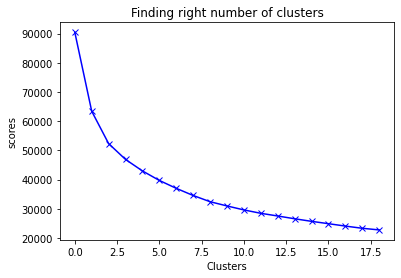

In [119]:
scores_2 = []

range_values = range(1, 20)

for i in range_values:
  kmeans = KMeans(n_clusters= i)
  kmeans.fit(pred)
  scores_2.append(kmeans.inertia_)

plt.plot(scores_2, 'bx-')
plt.title('Finding right number of clusters')
plt.xlabel('Clusters')
plt.ylabel('scores') 
plt.show()

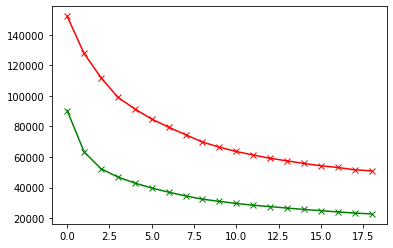

In [120]:
plt.plot(scores_1, 'bx-', color = 'r')
plt.plot(scores_2, 'bx-', color = 'g')

In [121]:
kmeans = KMeans(4)
kmeans.fit(pred)
labels = kmeans.labels_
y_kmeans = kmeans.fit_predict(creditcard_df_scaled)

In [122]:
df_cluster_dr = pd.concat([creditcard_df, pd.DataFrame({'cluster':labels})], axis = 1)
df_cluster_dr.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,2
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,2
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,2
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,2


In [123]:
pca = PCA(n_components=2)
prin_comp = pca.fit_transform(pred)
pca_df = pd.DataFrame(data = prin_comp, columns =['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,-2.105174,-0.410726
1,2.992509,-1.652286
2,-1.073154,0.535777
3,-1.068414,-0.936186
4,-1.990984,-0.206334


In [124]:
pca_df = pd.concat([pca_df,pd.DataFrame({'cluster':labels})], axis = 1)
pca_df.head()

,pca1,pca2,cluster
0,-2.105174,-0.410726,2
1,2.992509,-1.652286,1
2,-1.073154,0.535777,2
3,-1.068414,-0.936186,2
4,-1.990984,-0.206334,2


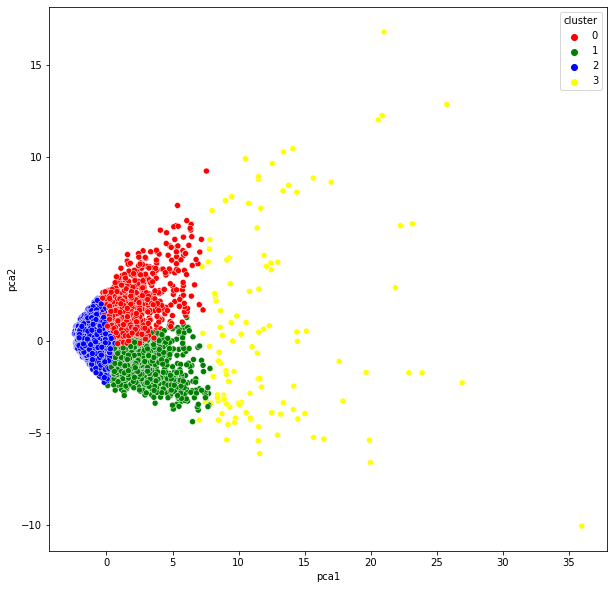

In [125]:
plt.figure(figsize=(10,10))
ax = sns.scatterplot(x="pca1", y="pca2", hue = "cluster", data = pca_df, palette =['red','green','blue','yellow'])
plt.show()

# Stocks Sentiment Analysis Using AI

***We live in a world where we are constantly bombarded with social
media feeds, tweets, and news articles. This huge data could be leveraged to predict people sentiment
towards a particular company or stock. Natural language processing (NLP) works by converting words (text)
into numbers. These numbers are then used to train an Al/ML model
to make predictions. AI/ML-based sentiment analysis models, can be used to
understand the sentiment from public tweets, which could be used as a factor while making a buy/sell decision of securities.***

## IMPORT LIBRARIES/DATASETS AND PERFORM EXPLORATORY DATA ANALYSIS

In [127]:
# install nltk
# NLTK: Natural Language tool kit
!pip install nltk

In [128]:
# install gensim
# Gensim is an open-source library for unsupervised topic modeling and natural language processing
# Gensim is implemented in Python and Cython.
!pip install gensim

In [129]:
# import key libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import nltk
import re
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
import plotly.express as px

# Tensorflow
import tensorflow as tf
from tensorflow.keras.preprocessing.text import one_hot,Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Embedding, Input, LSTM, Conv1D, MaxPool1D, Bidirectional, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical

In [130]:
# load the stock news data
stock_df = pd.read_csv("/content/drive/MyDrive/my files/Financial Analysis/stock_sentiment.csv")

In [135]:
# Let's view the dataset 
stock_df.head()

,Text,Sentiment
0,Kickers on my watchlist XIDE TIT SOQ PNK CPW B...,1
1,user: AAP MOVIE. 55% return for the FEA/GEED i...,1
2,user I'd be afraid to short AMZN - they are lo...,1
3,MNTA Over 12.00,1
4,OI Over 21.37,1


In [132]:
# dataframe information
stock_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5791 entries, 0 to 5790
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Text       5791 non-null   object
 1   Sentiment  5791 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 90.6+ KB


In [133]:
# check for null values
stock_df.isnull().sum()

Text         0
Sentiment    0
dtype: int64

## PERFORM DATA CLEANING (REMOVE PUNCTUATIONS FROM TEXT)

In [136]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [137]:
Test = '$I love AI & Machine learning!!'
Test_punc_removed = [char for char in Test if char not in string.punctuation]
Test_punc_removed_join = ''.join(Test_punc_removed)
Test_punc_removed_join

'I love AI  Machine learning'

In [138]:
Test = 'Good morning beautiful people :)... #I am having fun learning Finance with Python!!'

In [ ]:
Test_punc_removed = [char for char in Test if char not in string.punctuation]
Test_punc_removed

In [140]:
# Join the characters again to form the string.
Test_punc_removed_join = ''.join(Test_punc_removed)
Test_punc_removed_join

'Good morning beautiful people  I am having fun learning Finance with Python'

In [141]:
# Let's define a function to remove punctuations
def remove_punc(message):
    Test_punc_removed = [char for char in message if char not in string.punctuation]
    Test_punc_removed_join = ''.join(Test_punc_removed)

    return Test_punc_removed_join

In [142]:
# Let's remove punctuations from our dataset 
stock_df['Text Without Punctuation'] = stock_df['Text'].apply(remove_punc)

In [143]:
stock_df.head()

,Text,Sentiment,Text Without Punctuation
0,Kickers on my watchlist XIDE TIT SOQ PNK CPW B...,1,Kickers on my watchlist XIDE TIT SOQ PNK CPW B...
1,user: AAP MOVIE. 55% return for the FEA/GEED i...,1,user AAP MOVIE 55 return for the FEAGEED indic...
2,user I'd be afraid to short AMZN - they are lo...,1,user Id be afraid to short AMZN they are look...
3,MNTA Over 12.00,1,MNTA Over 1200
4,OI Over 21.37,1,OI Over 2137


In [144]:
stock_df['Text'][2]

"user I'd be afraid to short AMZN - they are looking like a near-monopoly in eBooks and infrastructure-as-a-service"

In [145]:
stock_df['Text Without Punctuation'][2]

'user Id be afraid to short AMZN  they are looking like a nearmonopoly in eBooks and infrastructureasaservice'

***Remove punctuations using a different method***

In [146]:
Test_punc_removed = []
for char in Test: 
    if char not in string.punctuation:
        Test_punc_removed.append(char)

# Join the characters again to form the string.
Test_punc_removed_join = ''.join(Test_punc_removed)
Test_punc_removed_join

'Good morning beautiful people  I am having fun learning Finance with Python'

## PERFORM DATA CLEANING (REMOVE STOPWORDS)

In [147]:
# download stopwords
nltk.download("stopwords")
stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [148]:
# Obtain additional stopwords from nltk
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use','will','aap','co','day','user','stock','today','week','year'])
# stop_words.extend(['from', 'subject', 're', 'edu', 'use','will','aap','co','day','user','stock','today','week','year', 'https'])

In [149]:
# Remove stopwords and remove short words (less than 2 characters)
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if len(token) >= 3 and token not in stop_words:
            result.append(token)
            
    return result

In [150]:
# apply pre-processing to the text column
stock_df['Text Without Punc & Stopwords'] = stock_df['Text Without Punctuation'].apply(preprocess)

In [151]:
stock_df['Text'][0]

'Kickers on my watchlist XIDE TIT SOQ PNK CPW BPZ AJ  trade method 1 or method 2, see prev posts'

In [152]:
stock_df['Text Without Punc & Stopwords'][0]

['kickers',
 'watchlist',
 'xide',
 'tit',
 'soq',
 'pnk',
 'cpw',
 'bpz',
 'trade',
 'method',
 'method',
 'see',
 'prev',
 'posts']

In [154]:
# join the words into a string
# stock_df['Processed Text 2'] = stock_df['Processed Text 2'].apply(lambda x: " ".join(x))

In [153]:
stock_df.head()

,Text,Sentiment,Text Without Punctuation,Text Without Punc & Stopwords
0,Kickers on my watchlist XIDE TIT SOQ PNK CPW B...,1,Kickers on my watchlist XIDE TIT SOQ PNK CPW B...,"[kickers, watchlist, xide, tit, soq, pnk, cpw,..."
1,user: AAP MOVIE. 55% return for the FEA/GEED i...,1,user AAP MOVIE 55 return for the FEAGEED indic...,"[movie, return, feageed, indicator, trades, aw..."
2,user I'd be afraid to short AMZN - they are lo...,1,user Id be afraid to short AMZN they are look...,"[afraid, short, amzn, looking, like, nearmonop..."
3,MNTA Over 12.00,1,MNTA Over 1200,[mnta]
4,OI Over 21.37,1,OI Over 2137,[]


Modify the code in order keep words that are longer than or equal 2 characters instead of 3

Add 'https' to the list of stopwords and rerun the code

In [155]:
# Obtain additional stopwords from nltk
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use','will','aap','co','day','user','stock','today','week','year', 'https'])

In [156]:
# Remove stopwords and remove words with 2 or less characters
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) >= 2 and token not in stop_words:
            result.append(token)
            
    return result

## PLOT WORDCLOUD

In [157]:
# join the words into a string
stock_df['Text Without Punc & Stopwords Joined'] = stock_df['Text Without Punc & Stopwords'].apply(lambda x: " ".join(x))

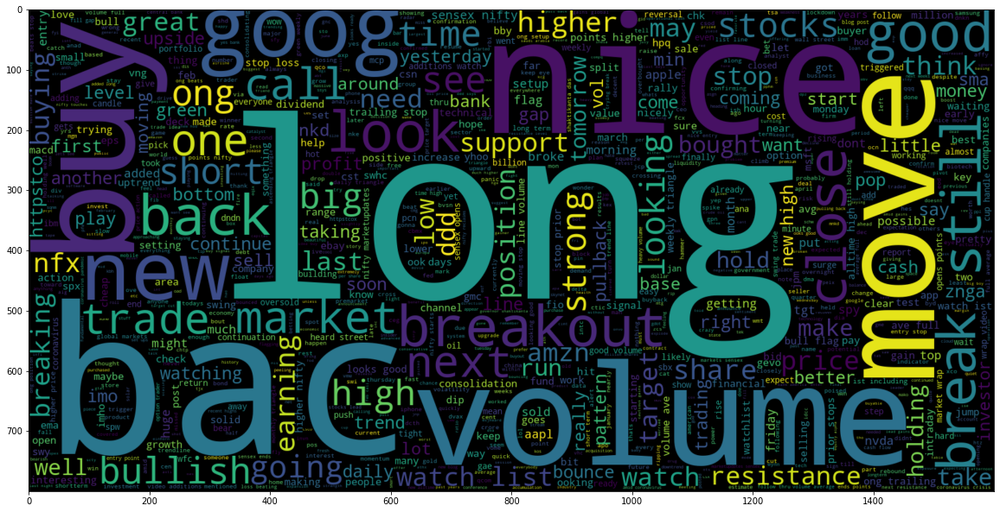

In [158]:
# plot the word cloud for text with positive sentiment
plt.figure(figsize = (20, 20)) 
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800).generate(" ".join(stock_df[stock_df['Sentiment'] == 1]['Text Without Punc & Stopwords Joined']))
plt.imshow(wc, interpolation = 'bilinear');

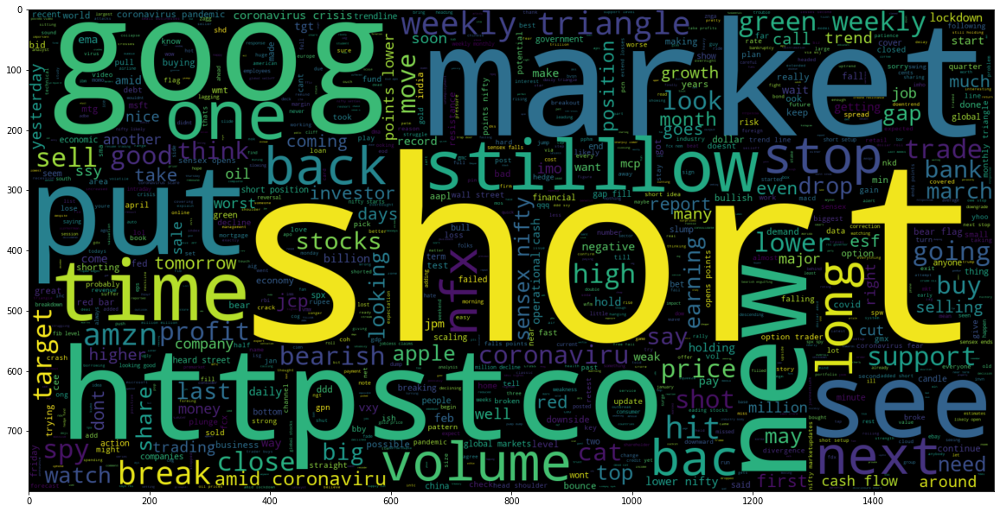

In [159]:
# plot the word cloud for text that is negative
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 1000, width = 1600, height = 800 ).generate(" ".join(stock_df[stock_df['Sentiment'] == 0]['Text Without Punc & Stopwords Joined']))
plt.imshow(wc, interpolation = 'bilinear');

## VISUALIZE CLEANED DATASETS

In [160]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [161]:
# word_tokenize is used to break up a string into words
print(stock_df['Text Without Punc & Stopwords Joined'][0])
print(nltk.word_tokenize(stock_df['Text Without Punc & Stopwords Joined'][0]))

kickers watchlist xide tit soq pnk cpw bpz trade method method see prev posts
['kickers', 'watchlist', 'xide', 'tit', 'soq', 'pnk', 'cpw', 'bpz', 'trade', 'method', 'method', 'see', 'prev', 'posts']


In [162]:
# Obtain the maximum length of data in the document
# This will be later used when word embeddings are generated
maxlen = -1
for doc in stock_df['Text Without Punc & Stopwords Joined']:
    tokens = nltk.word_tokenize(doc)
    if(maxlen < len(tokens)):
        maxlen = len(tokens)
print("The maximum number of words in any document is:", maxlen)

The maximum number of words in any document is: 20


In [163]:
tweets_length = [ len(nltk.word_tokenize(x)) for x in stock_df['Text Without Punc & Stopwords Joined'] ]
tweets_length

[14,
 6,
 7,
 1,
 0,
 1,
 8,
 13,
 8,
 4,
 10,
 18,
 8,
 8,
 11,
 5,
 12,
 10,
 12,
 4,
 6,
 5,
 2,
 5,
 3,
 10,
 3,
 3,
 9,
 6,
 8,
 10,
 8,
 3,
 10,
 11,
 4,
 8,
 11,
 10,
 10,
 7,
 9,
 8,
 4,
 10,
 8,
 7,
 7,
 9,
 10,
 10,
 8,
 2,
 14,
 12,
 9,
 8,
 1,
 14,
 7,
 11,
 5,
 13,
 6,
 6,
 7,
 6,
 6,
 10,
 9,
 4,
 10,
 13,
 16,
 6,
 9,
 6,
 2,
 11,
 5,
 4,
 9,
 11,
 16,
 4,
 9,
 5,
 6,
 2,
 1,
 5,
 9,
 4,
 7,
 6,
 7,
 10,
 1,
 3,
 9,
 4,
 16,
 8,
 10,
 11,
 18,
 6,
 7,
 13,
 12,
 9,
 3,
 3,
 10,
 10,
 8,
 6,
 8,
 5,
 5,
 8,
 9,
 15,
 3,
 5,
 9,
 18,
 13,
 11,
 3,
 1,
 1,
 2,
 7,
 12,
 12,
 8,
 8,
 10,
 9,
 10,
 15,
 8,
 9,
 9,
 12,
 10,
 6,
 10,
 13,
 4,
 11,
 8,
 15,
 13,
 8,
 12,
 5,
 5,
 3,
 7,
 2,
 4,
 10,
 5,
 6,
 10,
 6,
 16,
 9,
 6,
 5,
 10,
 9,
 10,
 8,
 2,
 10,
 9,
 10,
 12,
 7,
 10,
 7,
 3,
 6,
 5,
 9,
 9,
 4,
 6,
 5,
 4,
 4,
 8,
 10,
 8,
 8,
 13,
 9,
 7,
 10,
 12,
 8,
 6,
 5,
 3,
 10,
 11,
 6,
 9,
 10,
 13,
 10,
 7,
 12,
 7,
 11,
 10,
 4,
 4,
 3,
 10,
 2,
 9,
 10,
 15,
 12,
 10

In [164]:
# Plot the distribution for the number of words in a text
fig = px.histogram(x = tweets_length, nbins = 50)
fig.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



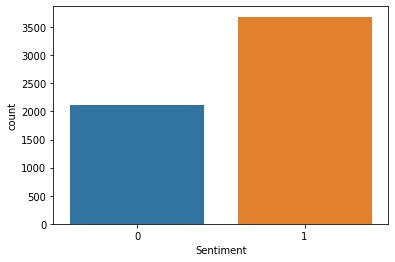

In [165]:
# plot the word count
sns.countplot(stock_df['Sentiment'])

## PREPARE THE DATA BY TOKENIZING AND PADDING

### TOKENIZER
***Tokenizer allows us to vectorize text corpus. Tokenization works by turning each text into a sequence of integers.***

For example:

SENTENCE: "budget fight looms republicans flip fiscal script Washington Reuters head conservative republican faction congress voted month."

TOKENS: [3138, 3581, 2895, 27, 5354, 22457, 3505, 9, 3138, 35, 2895, 208, 213, 3581, 29, 71,5354, 22457,1275, 335, 2, 619,2903, 27, 10461 43213, 4908, ...]

In [166]:
# Obtain the total words present in the dataset
list_of_words = []
for i in stock_df['Text Without Punc & Stopwords']:
    for j in i:
        list_of_words.append(j)


In [167]:
# Obtain the total number of unique words
total_words = len(list(set(list_of_words)))
total_words

9268

In [168]:
# split the data into test and train 
X = stock_df['Text Without Punc & Stopwords']
y = stock_df['Sentiment']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1)

In [169]:
X_train.shape

(5211,)

In [170]:
X_test.shape

(580,)

In [181]:
X_train

3767            [ooking, revesal, app, back, level, soon]
1319                                          [apa, back]
2088    [schwing, bingo, nkd, please, sell, feb, call,...
5465    [operations, three, ports, run, adani, ports, ...
3869                       [weekly, triangle, jvapdating]
                              ...                        
2375    [specialty, chemicals, slowly, approaching, ne...
1663    [key, holding, support, facing, resistance, wa...
1675                      [trade, ideas, onxx, nve, bgcp]
4914    [bac, like, watching, plant, grow, doto, posit...
3171       [long, yhoo, daily, setup, looks, great, pass]
Name: Text Without Punc & Stopwords, Length: 5211, dtype: object

In [180]:
y_train

3767    1
1319    1
2088    1
5465    0
3869    1
       ..
2375    1
1663    1
1675    1
4914    1
3171    1
Name: Sentiment, Length: 5211, dtype: int64

In [171]:
# Create a tokenizer to tokenize the words and create sequences of tokenized words
tokenizer = Tokenizer(num_words = total_words)
tokenizer.fit_on_texts(X_train)

# Training data
train_sequences = tokenizer.texts_to_sequences(X_train)

# Testing data
test_sequences = tokenizer.texts_to_sequences(X_test)


In [182]:
train_sequences

[[286, 3637, 368, 13, 100, 101],
 [1127, 13],
 [3638, 1300, 135, 871, 72, 159, 107, 785, 556, 3639],
 [872, 557, 2466, 97, 3640, 2466, 2467, 228, 3641, 3642],
 [30, 23, 3643],
 [609, 1552, 368, 3644],
 [640, 2, 786, 19, 39, 324, 345, 4, 89],
 [40, 30, 23, 3645, 435],
 [525, 11, 3],
 [241, 86, 985, 873, 3646, 1301, 87],
 [703, 129, 133, 874, 100, 2468, 1],
 [346, 129, 4],
 [1884, 1553, 558, 641, 2469, 2470, 18, 168, 16, 1885, 3647],
 [60, 787, 57, 14, 642, 91, 16, 17, 189, 2, 69],
 [229, 42, 5, 2471, 56],
 [8, 1554, 1302, 287, 1303],
 [1886, 460],
 [67, 3648, 2472, 875, 3649, 788, 120, 264, 3650, 1304],
 [704, 876, 789, 325, 32, 347, 61, 436, 48, 49],
 [218, 3, 1887, 3651],
 [1555, 27, 1556, 147, 82, 46, 68],
 [77, 1305, 347],
 [3652, 610, 347, 32, 230],
 [34, 986],
 [1557, 1306, 197, 877, 103, 101, 189, 788, 104, 2473, 3653, 437],
 [22, 248, 9, 288, 148],
 [1307, 406, 1308, 164, 3654, 3655, 1558, 168, 6, 15, 49],
 [3656, 1309, 25, 559, 178, 68, 14, 48, 1888],
 [1559, 3657, 3658, 1889, 

In [172]:
print("The encoding for document\n", X_train[1:2],"\n is: ", train_sequences[1])

The encoding for document
 1319    [apa, back]
Name: Text Without Punc & Stopwords, dtype: object 
 is:  [1127, 13]


In [173]:
# Add padding to training and testing
padded_train = pad_sequences(train_sequences, maxlen = 29, padding = 'post', truncating = 'post')
padded_test = pad_sequences(test_sequences, maxlen = 29, truncating = 'post')

In [183]:
padded_train

array([[ 286, 3637,  368, ...,    0,    0,    0],
       [1127,   13,    0, ...,    0,    0,    0],
       [3638, 1300,  135, ...,    0,    0,    0],
       ...,
       [  28,  644, 2444, ...,    0,    0,    0],
       [   8,    3,  132, ...,    0,    0,    0],
       [   4,  256,   76, ...,    0,    0,    0]], dtype=int32)

In [174]:
for i, doc in enumerate(padded_train[:3]):
     print("The padded encoding for document:", i+1," is:", doc)

The padded encoding for document: 1  is: [ 286 3637  368   13  100  101    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0]
The padded encoding for document: 2  is: [1127   13    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0]
The padded encoding for document: 3  is: [3638 1300  135  871   72  159  107  785  556 3639    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0]


In [175]:
# Convert the data to categorical 2D representation
y_train_cat = to_categorical(y_train, 2)
y_test_cat = to_categorical(y_test, 2)

In [179]:
y_train_cat

array([[0., 1.],
       [0., 1.],
       [0., 1.],
       ...,
       [0., 1.],
       [0., 1.],
       [0., 1.]], dtype=float32)

In [176]:
y_train_cat.shape

(5211, 2)

In [177]:
y_test_cat.shape

(580, 2)

## BUILD A CUSTOM-BASED DEEP NEURAL NETWORK TO PERFORM SENTIMENT ANALYSIS

### EMBEDDING LAYER
*   ***Embedding layers learn low-dimensional continuous representation of discrete input variables.***
*   ***For example, let say we have 100000 unique values in our data and want to train the model with these data. Though we can use these as such, it would require more resources to train. With embedding layer, you can specify the number of low-dimensjonal feature that you would need to represent the input data, in this case let's take the value to be 200.***
*   ***Now, what happens is embedding layer learns the way to represent 100000 variables with 200 variables, similar to Principal Component Analysis (PCA) or Autoencoder.***
*   ***This in-turn helps the subsequent layers to learn more effectively.***

In [199]:
# Sequential Model
model = Sequential()

# embedding layer
model.add(Embedding(total_words, output_dim = 512))

# Bi-Directional RNN and LSTM
model.add(LSTM(256))

# Dense layers
model.add(Dense(128, activation = 'relu'))
model.add(Dropout(0.3))
model.add(Dense(2,activation = 'softmax'))
model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['acc'])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, None, 512)         4745216   
                                                                 
 lstm_4 (LSTM)               (None, 256)               787456    
                                                                 
 dense_11 (Dense)            (None, 128)               32896     
                                                                 
 dropout_3 (Dropout)         (None, 128)               0         
                                                                 
 dense_12 (Dense)            (None, 2)                 258       
                                                                 
Total params: 5,565,826
Trainable params: 5,565,826
Non-trainable params: 0
_________________________________________________________________


In [200]:
# train the model
model.fit(padded_train, y_train_cat, batch_size = 32, validation_split = 0.2, epochs = 2)

Epoch 1/2
131/131 [==============================] - 44s 310ms/step - loss: 0.6632 - acc: 0.6329 - val_loss: 0.6583 - val_acc: 0.6309
Epoch 2/2
131/131 [==============================] - 39s 299ms/step - loss: 0.5511 - acc: 0.7267 - val_loss: 0.5249 - val_acc: 0.7517


## ASSESS TRAINED MODEL PERFORMANCE

In [201]:
# make prediction
pred = model.predict(padded_test)

In [202]:
# make prediction
prediction = []
for i in pred:
  prediction.append(np.argmax(i))

In [203]:
# list containing original values
original = []
for i in y_test_cat:
  original.append(np.argmax(i))

In [204]:
# acuracy score on text data
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(original, prediction)
accuracy

0.656896551724138

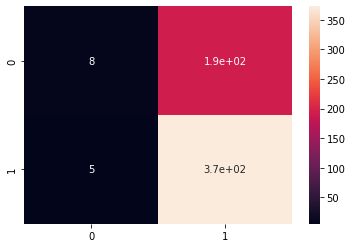

In [205]:
# Plot the confusion matrix
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(original, prediction)
sns.heatmap(cm, annot = True)